In [1]:
import torch

In [2]:
import torch.nn as nn
import torch


class AlexNet(nn.Module):
    def __init__(self, num_classes=1000, init_weights=False):
        super(AlexNet, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 48, kernel_size=11, stride=4, padding=2),  # input[3, 224, 224]  output[48, 55, 55]
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2),                  # output[48, 27, 27]
            nn.Conv2d(48, 128, kernel_size=5, padding=2),           # output[128, 27, 27]
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2),                  # output[128, 13, 13]
            nn.Conv2d(128, 192, kernel_size=3, padding=1),          # output[192, 13, 13]
            nn.ReLU(inplace=True),
            nn.Conv2d(192, 192, kernel_size=3, padding=1),          # output[192, 13, 13]
            nn.ReLU(inplace=True),
            nn.Conv2d(192, 128, kernel_size=3, padding=1),          # output[128, 13, 13]
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2),                  # output[128, 6, 6]
        )
        self.classifier = nn.Sequential(
            nn.Dropout(p=0.5),
            nn.Linear(128 * 6 * 6, 2048),
            nn.ReLU(inplace=True),
            nn.Dropout(p=0.5),
            nn.Linear(2048, 2048),
            nn.ReLU(inplace=True),
            nn.Linear(2048, num_classes),
        )
        if init_weights:
            self._initialize_weights()

    def forward(self, x):
        x = self.features(x)
        x = torch.flatten(x, start_dim=1)
        x = self.classifier(x)
        return x

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.normal_(m.weight, 0, 0.01)
                nn.init.constant_(m.bias, 0)

In [3]:
import os
import sys
import json

import torch
import torch.nn as nn
from torchvision import transforms, datasets, utils
import matplotlib.pyplot as plt
import numpy as np
import torch.optim as optim
from tqdm import tqdm

# from model import AlexNet

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("using {} device.".format(device))

data_transform = {
    "train": transforms.Compose([transforms.RandomResizedCrop(224),
                                 transforms.RandomHorizontalFlip(),
                                 transforms.ToTensor(),
                                 transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))]),
    "val": transforms.Compose([transforms.Resize((224, 224)),  # cannot 224, must (224, 224)
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])}


image_path = './input/head_ct/data/'


train_dataset = datasets.ImageFolder(transform=data_transform["train"],
                                     root=image_path+'train')
train_num = len(train_dataset)

# {'daisy':0, 'dandelion':1, 'roses':2, 'sunflower':3, 'tulips':4}
flower_list = train_dataset.class_to_idx
print(flower_list)
cla_dict = dict((val, key) for key, val in flower_list.items())
# write dict into json file
json_str = json.dumps(cla_dict, indent=4)
with open('class_indices.json', 'w') as json_file:
    json_file.write(json_str)

batch_size = 32
nw = min([os.cpu_count(), batch_size if batch_size > 1 else 0, 8])  # number of workers
print('Using {} dataloader workers every process'.format(nw))

train_loader = torch.utils.data.DataLoader(train_dataset,
                                           batch_size=batch_size, shuffle=True,
                                           num_workers=nw)

validate_dataset = datasets.ImageFolder(root=image_path+"val",
                                        transform=data_transform["val"])
val_num = len(validate_dataset)
validate_loader = torch.utils.data.DataLoader(validate_dataset,
                                              batch_size=4, shuffle=False,
                                              num_workers=nw)

print("using {} images for training, {} images for validation.".format(train_num,
                                                                       val_num))
# test_data_iter = iter(validate_loader)
# test_image, test_label = test_data_iter.next()
#
# def imshow(img):
#     img = img / 2 + 0.5  # unnormalize
#     npimg = img.numpy()
#     plt.imshow(np.transpose(npimg, (1, 2, 0)))
#     plt.show()
#
# print(' '.join('%5s' % cla_dict[test_label[j].item()] for j in range(4)))
# imshow(utils.make_grid(test_image))

net = AlexNet(num_classes=2, init_weights=True)

net.to(device)
loss_function = nn.CrossEntropyLoss()
# pata = list(net.parameters())
optimizer = optim.Adam(net.parameters(), lr=0.0002)

epochs = 1000
save_path = './AlexNet2.pth'
best_acc = 0.0
train_steps = len(train_loader)
for epoch in range(epochs):
    # train
    net.train()
    running_loss = 0.0
    train_bar = tqdm(train_loader, file=sys.stdout)
    for step, data in enumerate(train_bar):
        images, labels = data
        optimizer.zero_grad()
        outputs = net(images.to(device))
        loss = loss_function(outputs, labels.to(device))
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()

        train_bar.desc = "train epoch[{}/{}] loss:{:.3f}".format(epoch + 1,
                                                                 epochs,
                                                                 loss)

    # validate
    net.eval()
    acc = 0.0  # accumulate accurate number / epoch
    with torch.no_grad():
        val_bar = tqdm(validate_loader, file=sys.stdout)
        for val_data in val_bar:
            val_images, val_labels = val_data
            outputs = net(val_images.to(device))
            predict_y = torch.max(outputs, dim=1)[1]
            acc += torch.eq(predict_y, val_labels.to(device)).sum().item()

    val_accurate = acc / val_num
    print('[epoch %d] train_loss: %.3f  val_accuracy: %.3f' %
          (epoch + 1, running_loss / train_steps, val_accurate))

    if val_accurate > best_acc:
        best_acc = val_accurate
        torch.save(net.state_dict(), save_path)

print('Finished Training')



using cuda:0 device.
{'0': 0, '1': 1}
Using 8 dataloader workers every process
using 143 images for training, 60 images for validation.
100%|███████████████████████████████████████████| 15/15 [00:00<00:00, 16.09it/s]
[epoch 1] train_loss: 0.686  val_accuracy: 0.500
100%|███████████████████████████████████████████| 15/15 [00:01<00:00, 10.48it/s]
[epoch 2] train_loss: 0.676  val_accuracy: 0.517
100%|███████████████████████████████████████████| 15/15 [00:00<00:00, 27.34it/s]
[epoch 3] train_loss: 0.555  val_accuracy: 0.517
100%|███████████████████████████████████████████| 15/15 [00:00<00:00, 27.98it/s]
[epoch 4] train_loss: 0.472  val_accuracy: 0.517
100%|███████████████████████████████████████████| 15/15 [00:00<00:00, 29.08it/s]
[epoch 5] train_loss: 0.562  val_accuracy: 0.533
100%|███████████████████████████████████████████| 15/15 [00:00<00:00, 27.61it/s]
[epoch 6] train_loss: 0.496  val_accuracy: 0.733
100%|███████████████████████████████████████████| 15/15 [00:00<00:00, 28.01it/s]
[ep

Exception ignored in: <function _releaseLock at 0x7f2b1ad4e9e0>
Traceback (most recent call last):
  File "/home/ubuntu/miniconda3/envs/env/lib/python3.7/logging/__init__.py", line 221, in _releaseLock
    def _releaseLock():
KeyboardInterrupt


  0%|                                                     | 0/5 [00:05<?, ?it/s]


RuntimeError: DataLoader worker (pid(s) 27293, 27325) exited unexpectedly

In [4]:
import os
import json

import torch
from PIL import Image
from torchvision import transforms
import matplotlib.pyplot as plt



tensor([0.0053, 0.9947])
class: 0            prob: 0.00527
class: 1            prob: 0.995


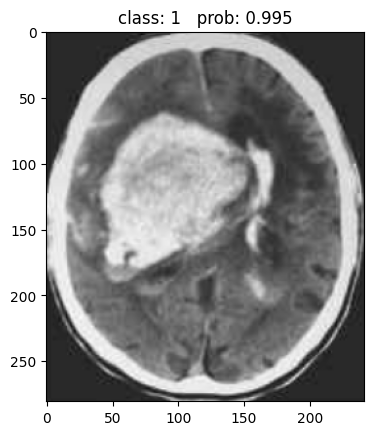

In [19]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

data_transform = transforms.Compose([transforms.Resize((224, 224)),  # cannot 224, must (224, 224)
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

# load image
img_path = "./input/head_ct/head_ct/066.png"
assert os.path.exists(img_path), "file: '{}' dose not exist.".format(img_path)
img = Image.open(img_path).convert('RGB')

plt.imshow(img)
# [N, C, H, W]
img = data_transform(img)
# expand batch dimension
img = torch.unsqueeze(img, dim=0)

# read class_indict
json_path = './class_indices.json'
assert os.path.exists(json_path), "file: '{}' dose not exist.".format(json_path)

with open(json_path, "r") as f:
    class_indict = json.load(f)

# create model
model = AlexNet(num_classes=2).to(device)

# load model weights
weights_path = "./AlexNet.pth"
assert os.path.exists(weights_path), "file: '{}' dose not exist.".format(weights_path)
model.load_state_dict(torch.load(weights_path))

model.eval()
with torch.no_grad():
    # predict class
    output = torch.squeeze(model(img.to(device))).cpu()
    predict = torch.softmax(output, dim=0)
    predict_cla = torch.argmax(predict).numpy()

print_res = "class: {}   prob: {:.3}".format(class_indict[str(predict_cla)],
                                             predict[predict_cla].numpy())
plt.title(print_res)
print(predict)

for i in range(len(predict)):
    print("class: {:10}   prob: {:.3}".format(class_indict[str(i)],
                                              predict[i].numpy()))
plt.show()

In [20]:
model = AlexNet(num_classes=2).to(device)

# load model weights
weights_path = "./AlexNet.pth"
assert os.path.exists(weights_path), "file: '{}' dose not exist.".format(weights_path)
model.load_state_dict(torch.load(weights_path))

<All keys matched successfully>

tensor([0.0019, 0.9981])


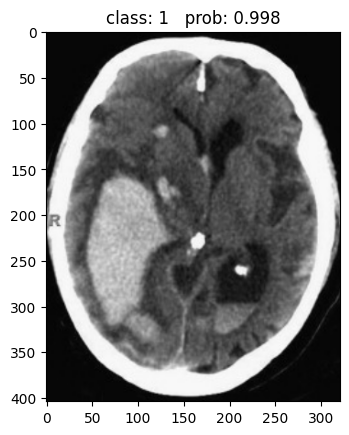

In [6]:
# load image
img_path = "./input/head_ct/head_ct/086.png"
img = Image.open(img_path).convert('RGB')

plt.imshow(img)
# [N, C, H, W]
img = data_transform(img)
# expand batch dimension
img = torch.unsqueeze(img, dim=0)

model.eval()
with torch.no_grad():
    # predict class
    output = torch.squeeze(model(img.to(device))).cpu()
    predict = torch.softmax(output, dim=0)
    predict_cla = torch.argmax(predict).numpy()

print_res = "class: {}   prob: {:.3}".format(class_indict[str(predict_cla)],
                                             predict[predict_cla].numpy())
plt.title(print_res)
print(predict)

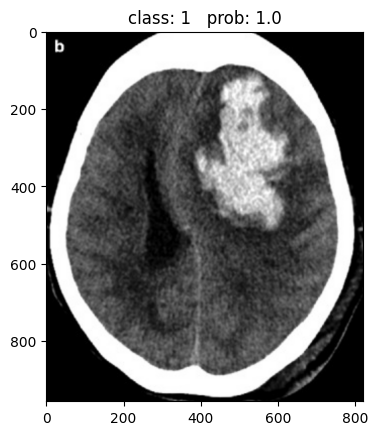

tensor([1.4617e-05, 9.9999e-01])


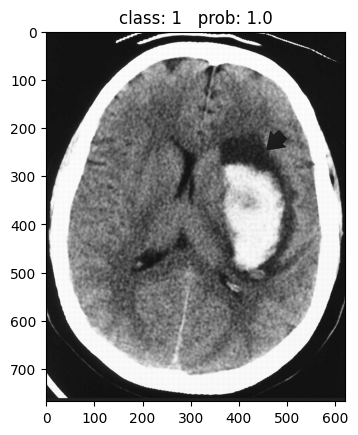

tensor([1.1124e-10, 1.0000e+00])


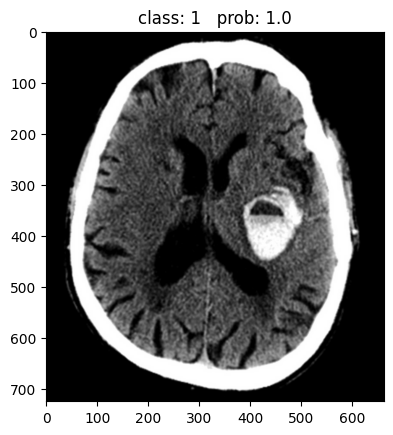

tensor([6.4691e-06, 9.9999e-01])


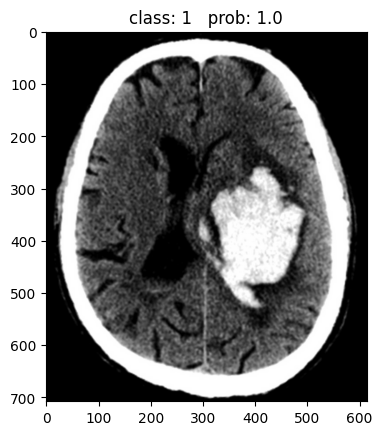

tensor([1.0473e-04, 9.9990e-01])


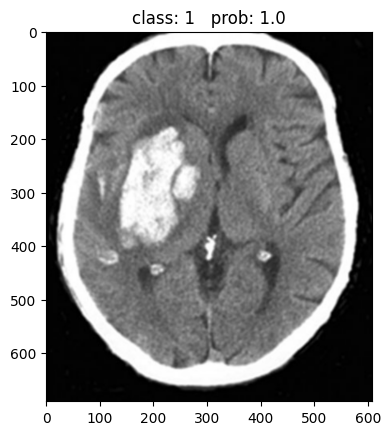

tensor([4.2907e-06, 1.0000e+00])


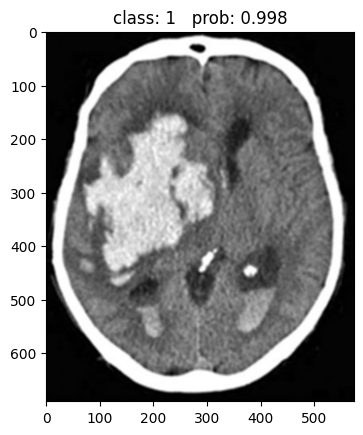

tensor([0.0022, 0.9978])


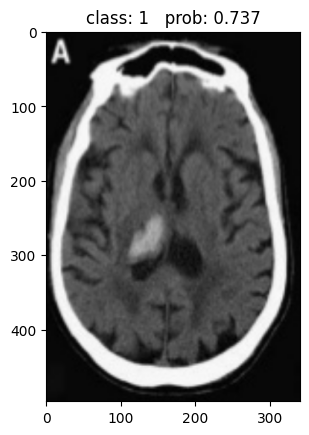

tensor([0.2626, 0.7374])


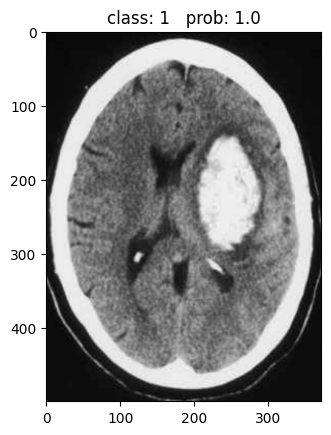

tensor([5.1514e-07, 1.0000e+00])


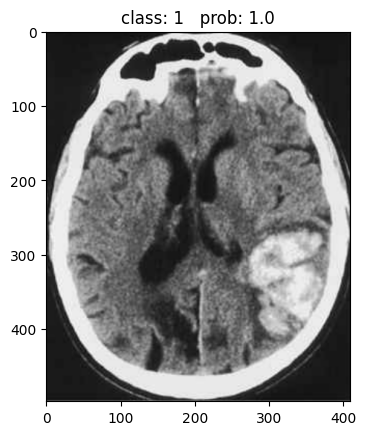

tensor([8.8724e-05, 9.9991e-01])


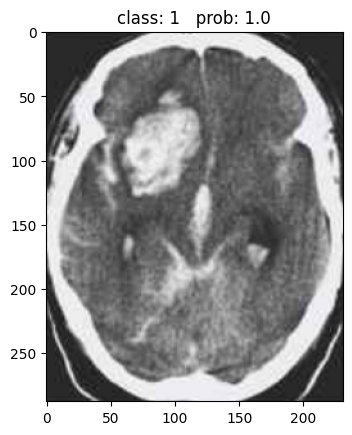

tensor([4.2768e-04, 9.9957e-01])


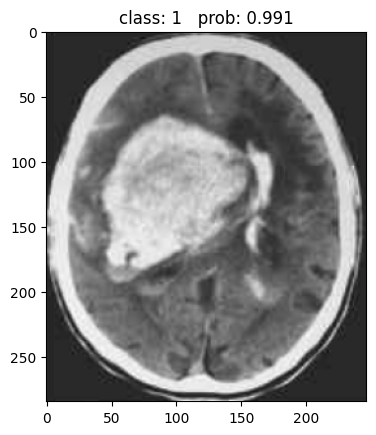

tensor([0.0094, 0.9906])


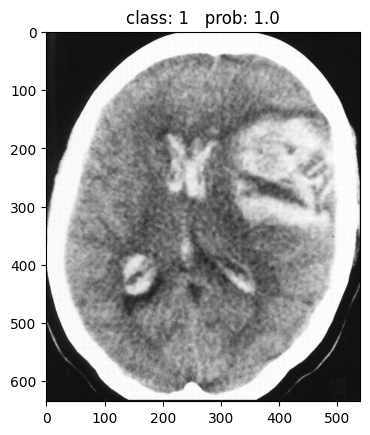

tensor([1.5702e-05, 9.9998e-01])


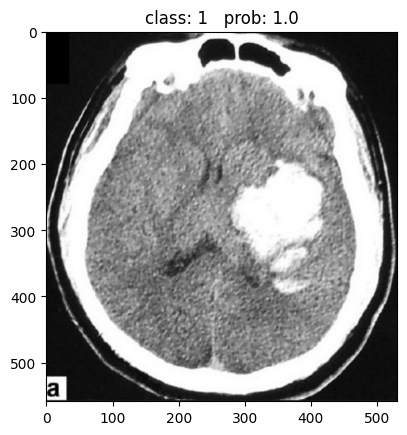

tensor([4.0704e-04, 9.9959e-01])


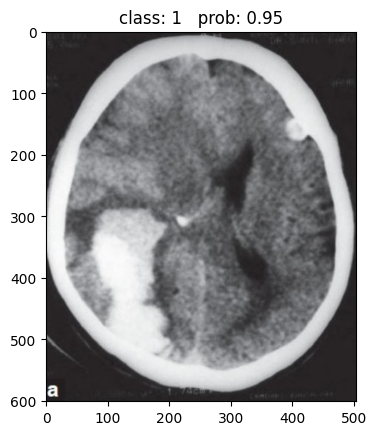

tensor([0.0502, 0.9498])


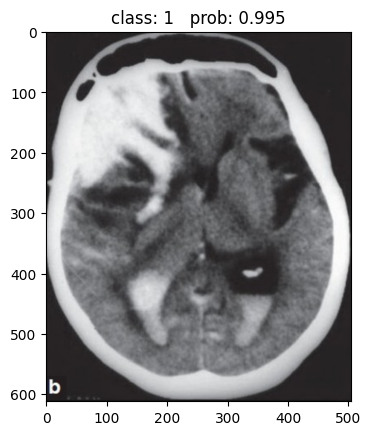

tensor([0.0050, 0.9950])


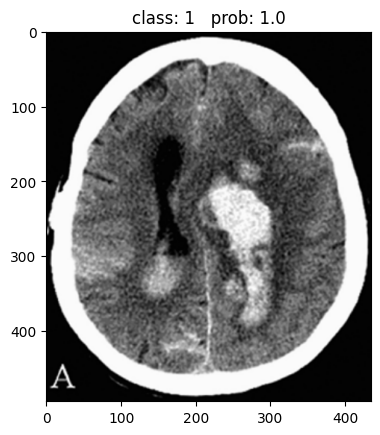

tensor([2.1924e-07, 1.0000e+00])


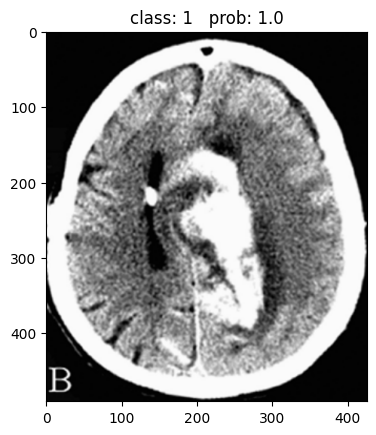

tensor([5.9257e-05, 9.9994e-01])


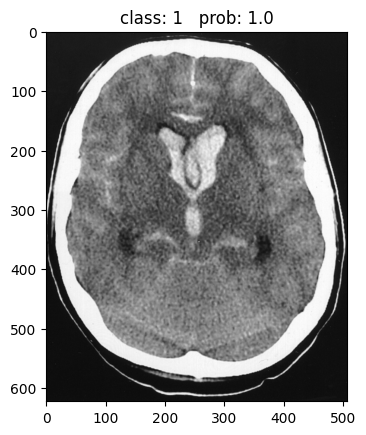

tensor([1.0260e-04, 9.9990e-01])


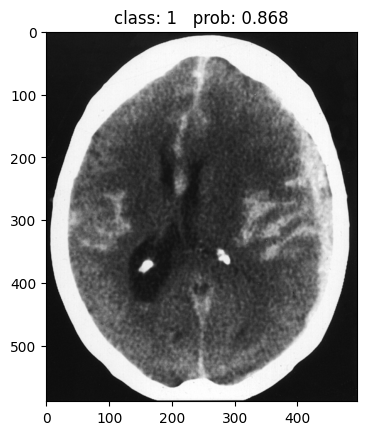

tensor([0.1316, 0.8684])


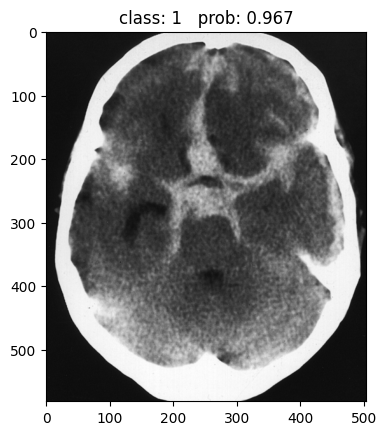

tensor([0.0329, 0.9671])


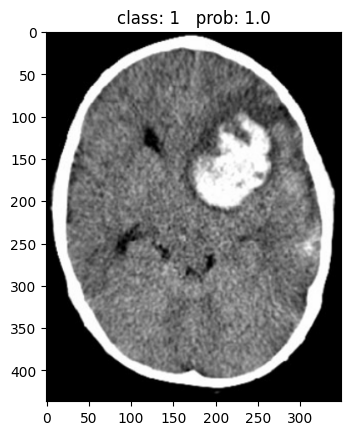

tensor([3.0829e-08, 1.0000e+00])


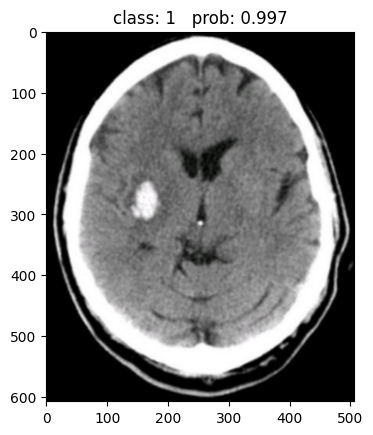

tensor([0.0032, 0.9968])


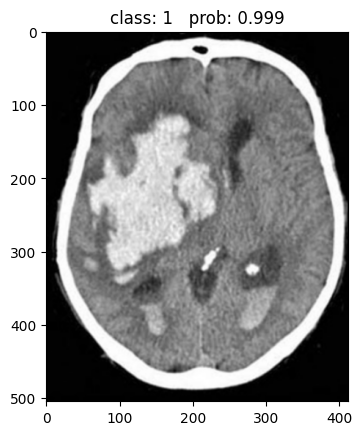

tensor([8.4814e-04, 9.9915e-01])


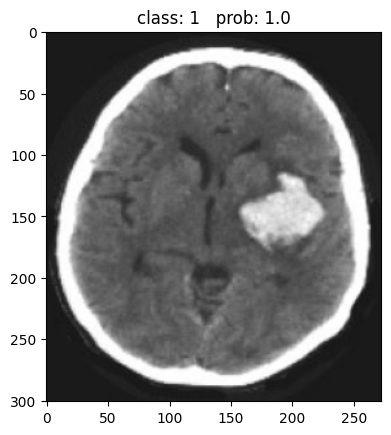

tensor([1.1518e-04, 9.9988e-01])


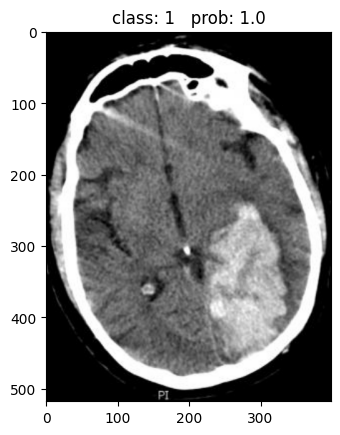

tensor([2.5999e-04, 9.9974e-01])


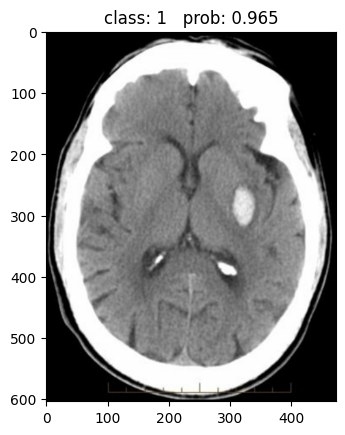

tensor([0.0349, 0.9651])


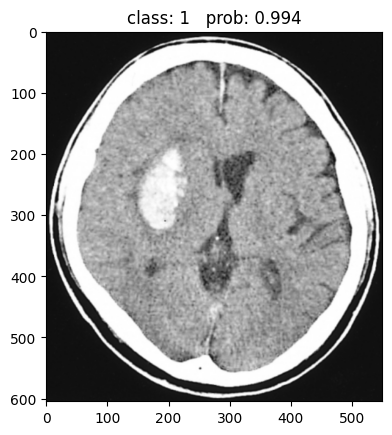

tensor([0.0064, 0.9936])


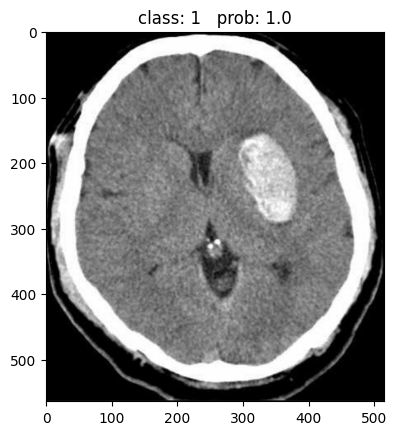

tensor([6.4455e-07, 1.0000e+00])


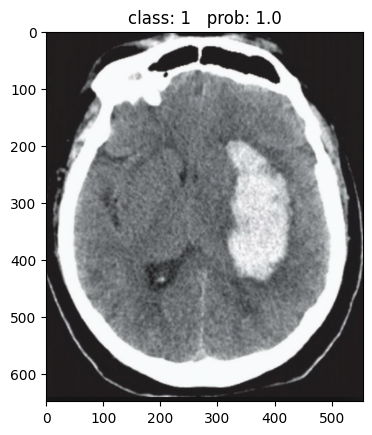

tensor([1.9617e-04, 9.9980e-01])


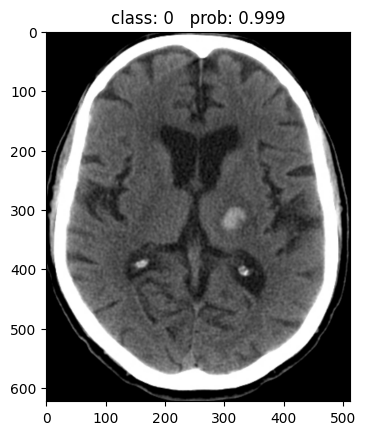

tensor([9.9915e-01, 8.4841e-04])


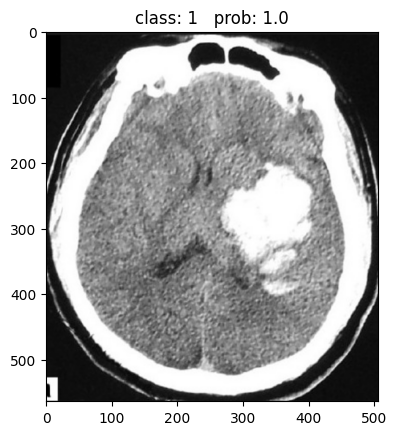

tensor([2.5376e-04, 9.9975e-01])


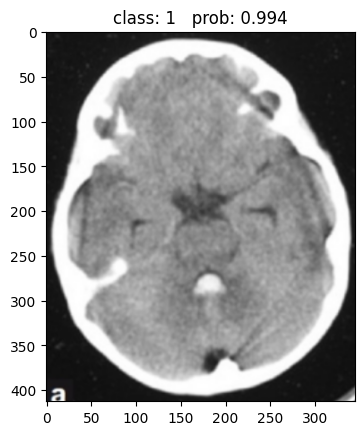

tensor([0.0062, 0.9938])


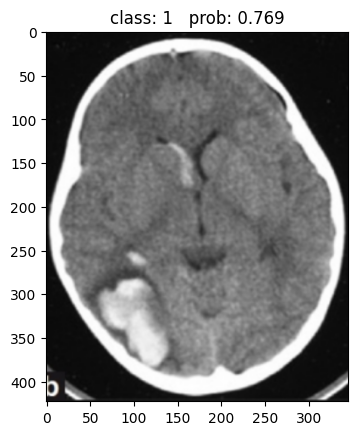

tensor([0.2315, 0.7685])


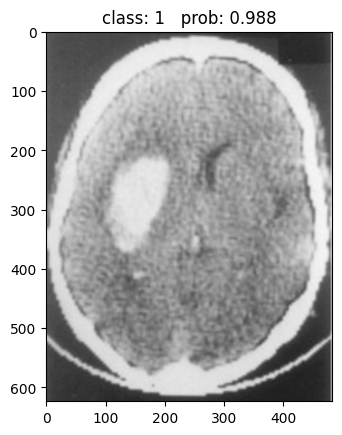

tensor([0.0120, 0.9880])


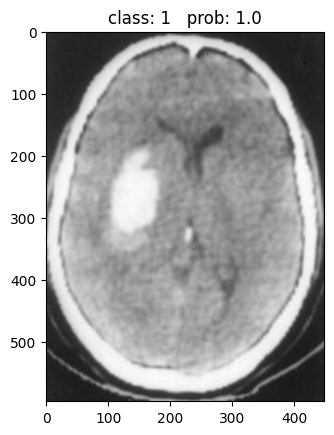

tensor([3.3633e-04, 9.9966e-01])


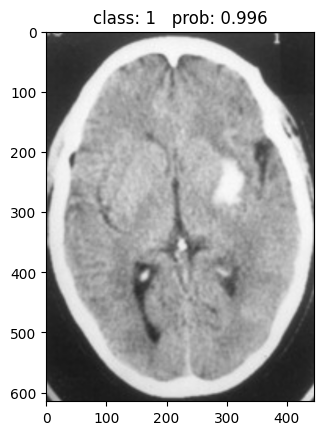

tensor([0.0043, 0.9957])


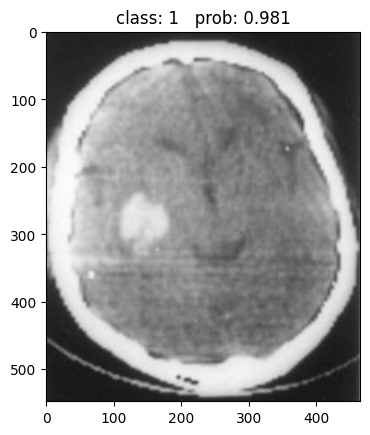

tensor([0.0195, 0.9805])


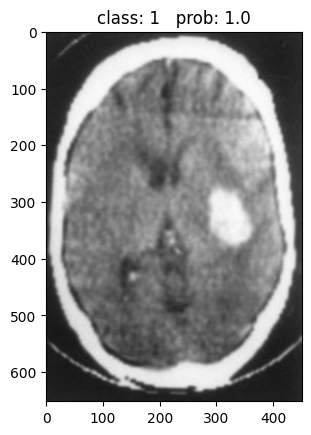

tensor([7.7834e-06, 9.9999e-01])


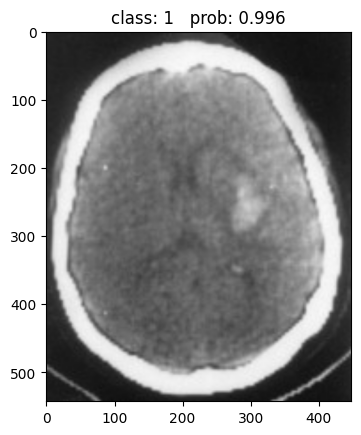

tensor([0.0043, 0.9957])


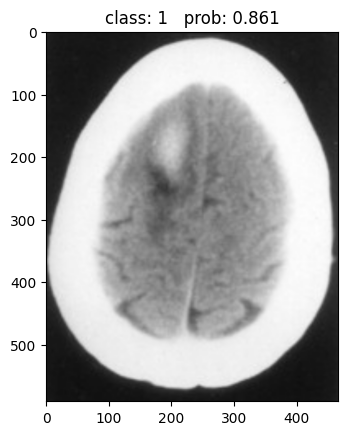

tensor([0.1393, 0.8607])


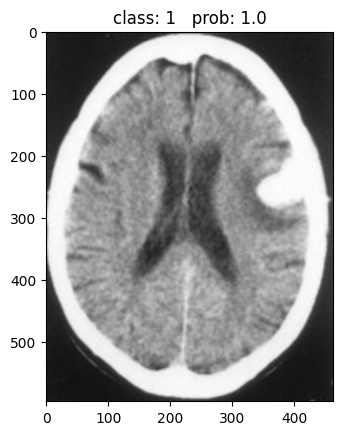

tensor([2.8721e-04, 9.9971e-01])


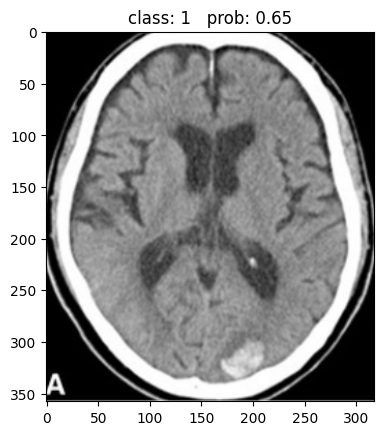

tensor([0.3497, 0.6503])


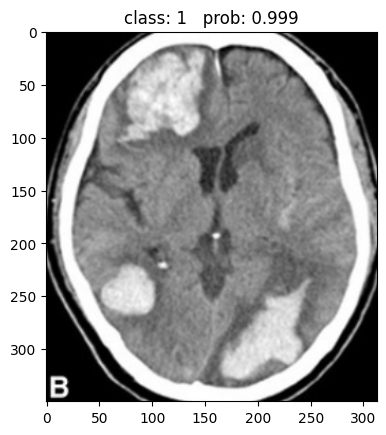

tensor([9.0296e-04, 9.9910e-01])


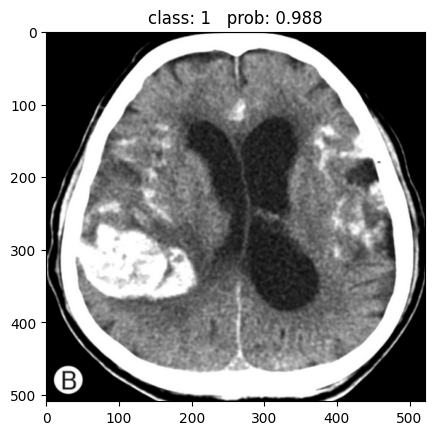

tensor([0.0121, 0.9879])


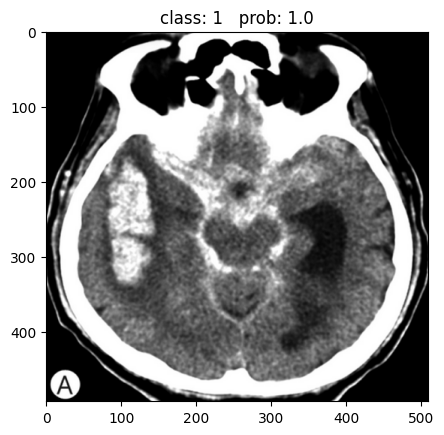

tensor([1.6728e-04, 9.9983e-01])


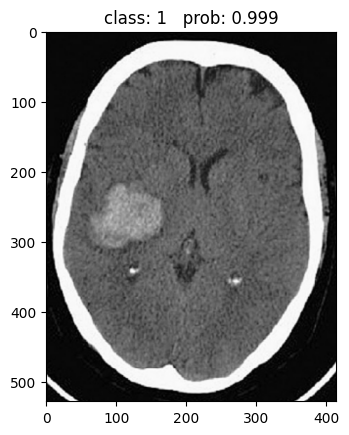

tensor([0.0014, 0.9986])


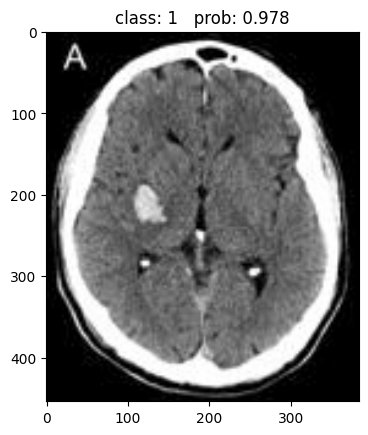

tensor([0.0217, 0.9783])


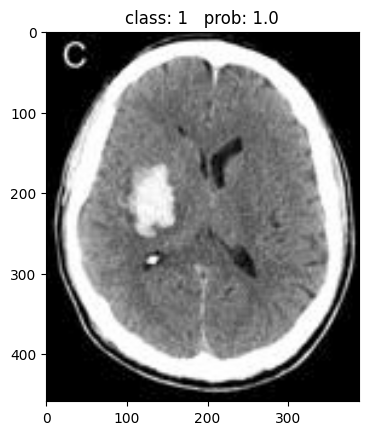

tensor([5.7350e-06, 9.9999e-01])


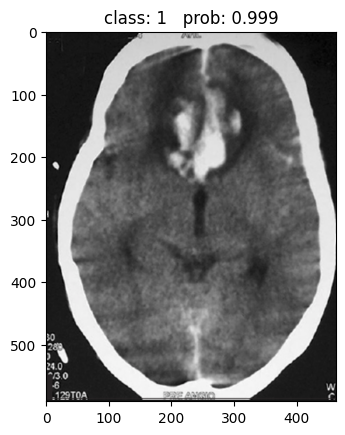

tensor([0.0014, 0.9986])


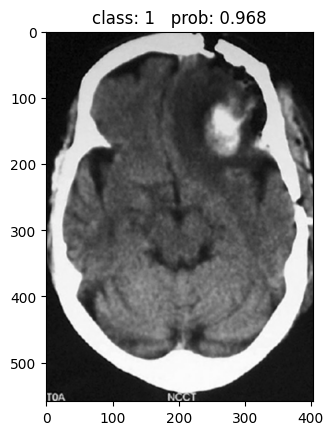

tensor([0.0317, 0.9683])


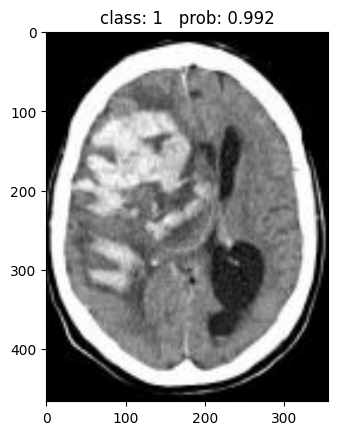

tensor([0.0077, 0.9923])


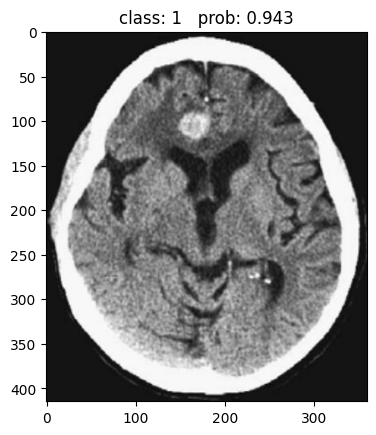

tensor([0.0573, 0.9427])


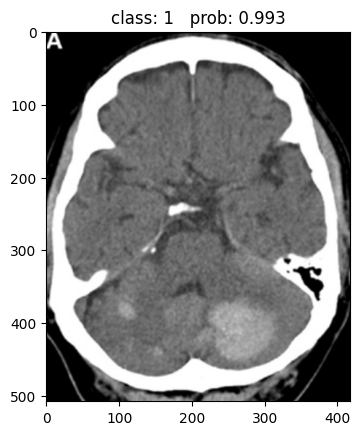

tensor([0.0073, 0.9927])


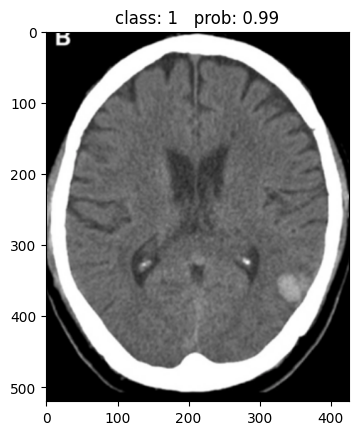

tensor([0.0096, 0.9904])


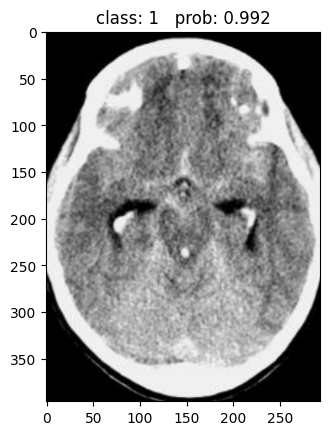

tensor([0.0079, 0.9921])


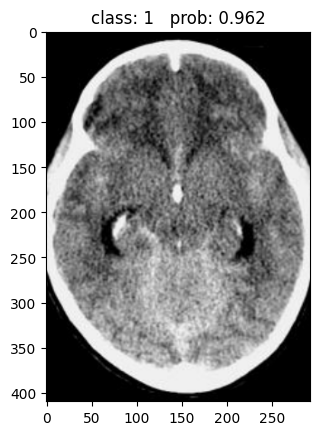

tensor([0.0379, 0.9621])


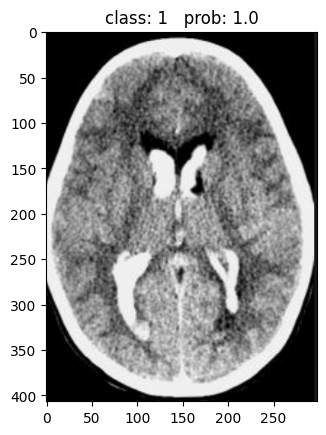

tensor([4.2269e-05, 9.9996e-01])


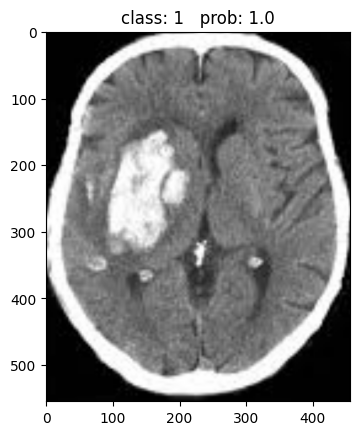

tensor([7.3795e-06, 9.9999e-01])


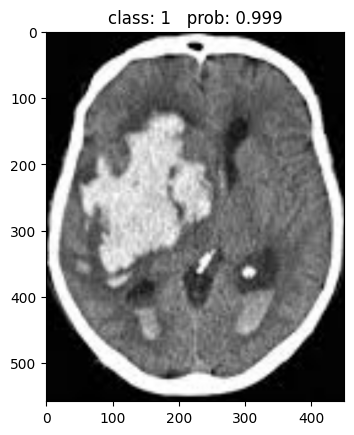

tensor([0.0013, 0.9987])


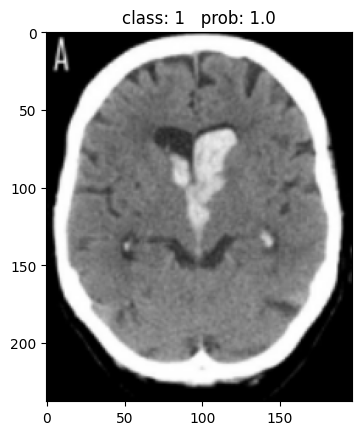

tensor([1.2967e-05, 9.9999e-01])


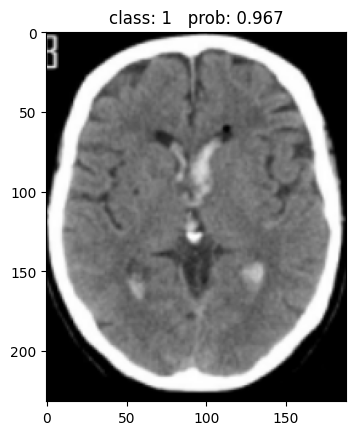

tensor([0.0332, 0.9668])


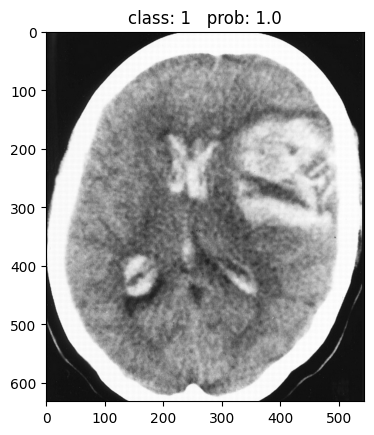

tensor([1.9841e-05, 9.9998e-01])


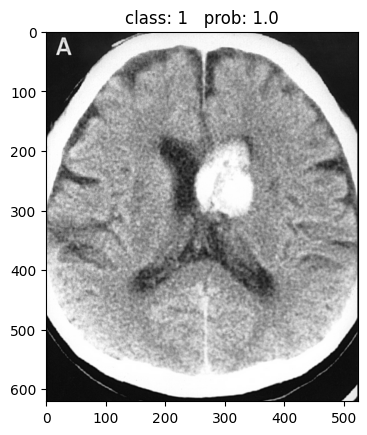

tensor([7.1513e-08, 1.0000e+00])


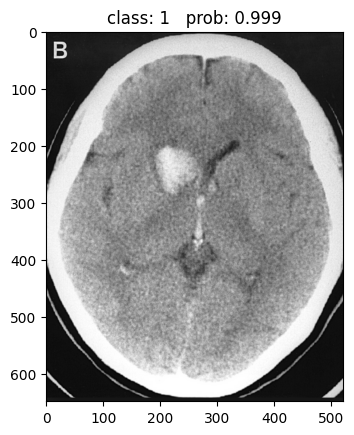

tensor([5.1525e-04, 9.9948e-01])


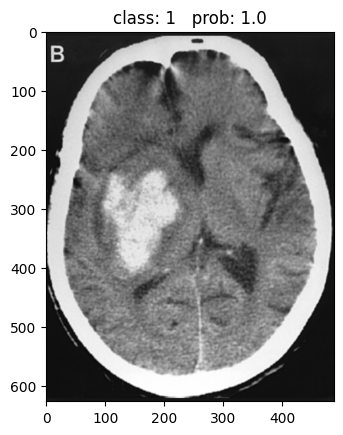

tensor([5.4044e-05, 9.9995e-01])


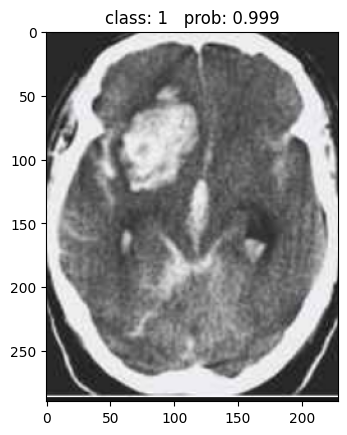

tensor([6.0684e-04, 9.9939e-01])


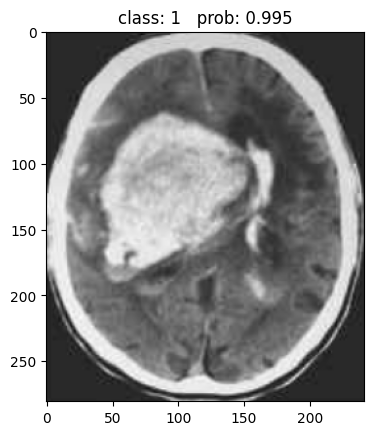

tensor([0.0053, 0.9947])


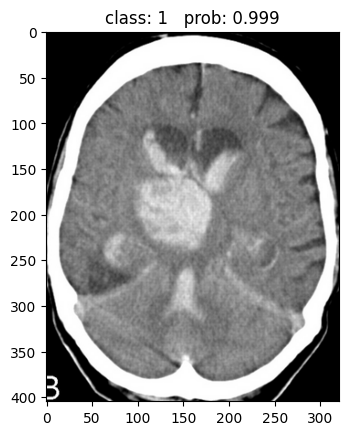

tensor([6.7093e-04, 9.9933e-01])


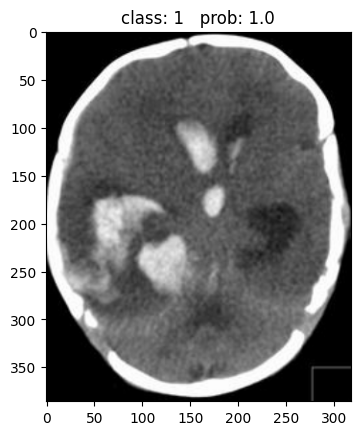

tensor([2.0481e-05, 9.9998e-01])


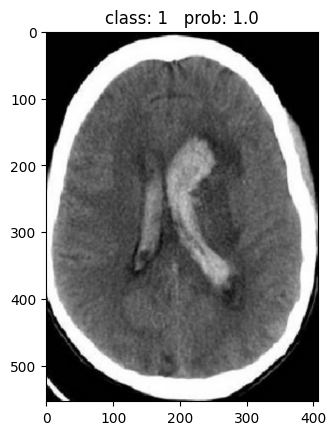

tensor([1.1777e-04, 9.9988e-01])


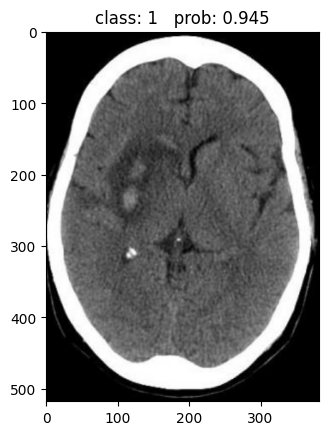

tensor([0.0552, 0.9448])


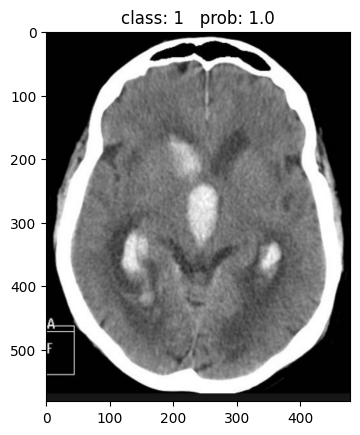

tensor([1.1812e-05, 9.9999e-01])


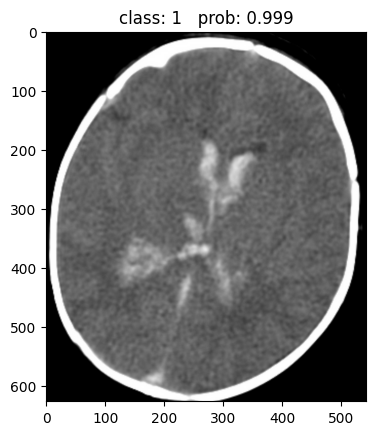

tensor([7.9189e-04, 9.9921e-01])


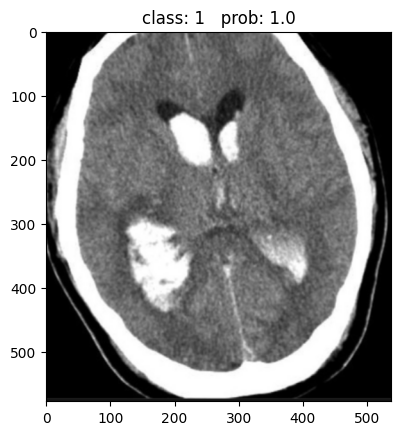

tensor([4.5775e-09, 1.0000e+00])


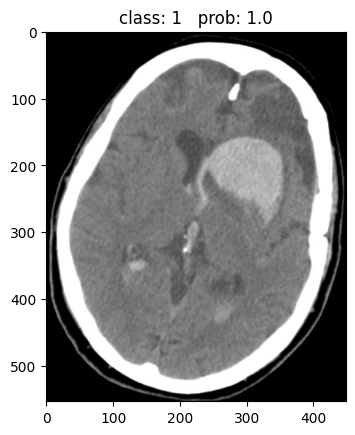

tensor([3.3059e-04, 9.9967e-01])


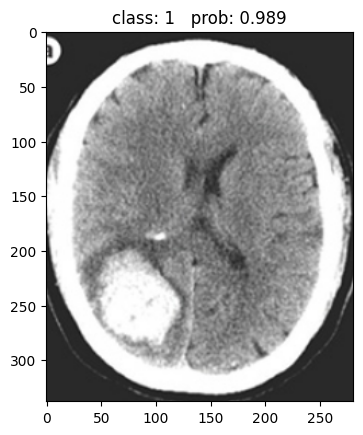

tensor([0.0111, 0.9889])


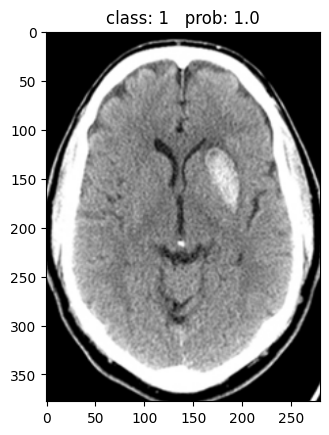

tensor([1.6080e-05, 9.9998e-01])


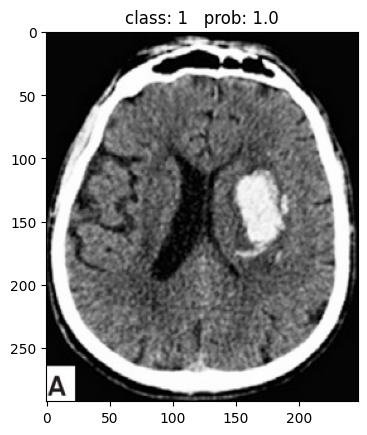

tensor([1.9099e-10, 1.0000e+00])


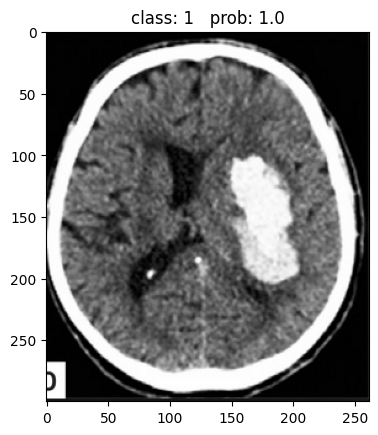

tensor([1.0633e-08, 1.0000e+00])


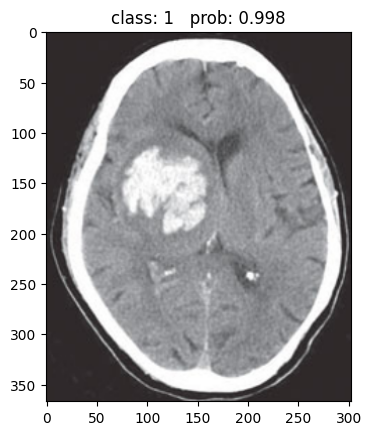

tensor([0.0024, 0.9976])


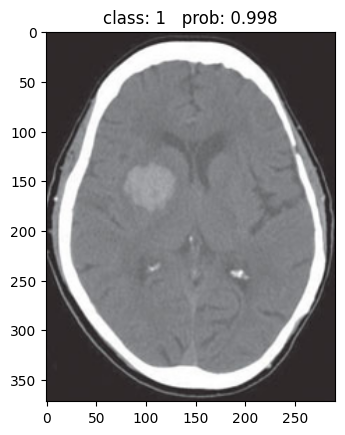

tensor([0.0017, 0.9983])


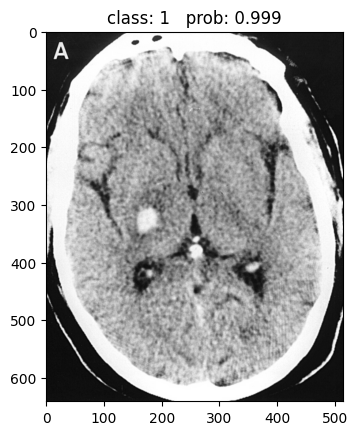

tensor([9.1378e-04, 9.9909e-01])


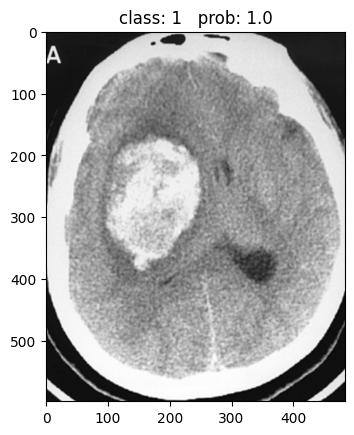

tensor([4.2044e-04, 9.9958e-01])


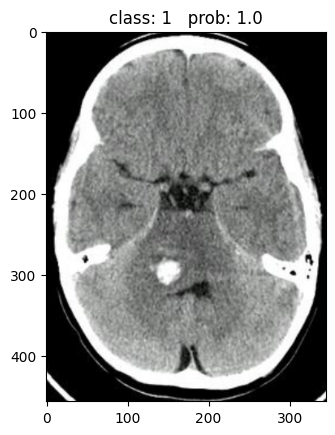

tensor([4.2021e-05, 9.9996e-01])


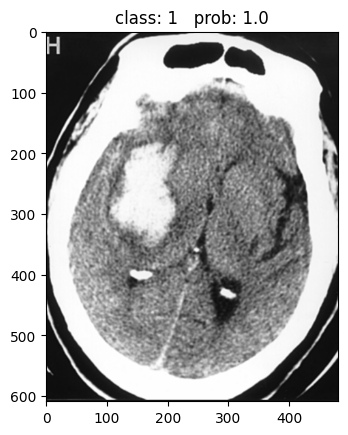

tensor([4.3610e-05, 9.9996e-01])


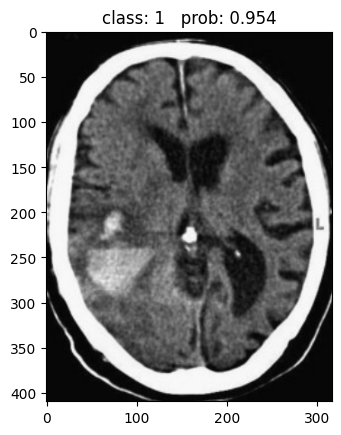

tensor([0.0456, 0.9544])


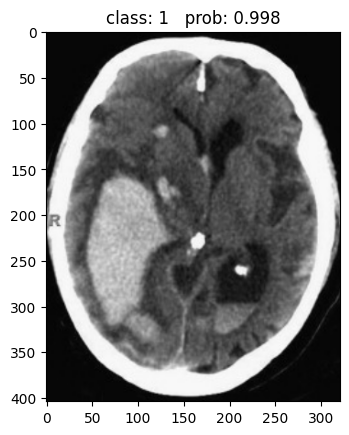

tensor([0.0019, 0.9981])


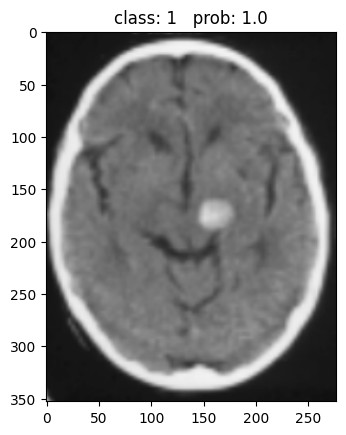

tensor([8.5532e-05, 9.9991e-01])


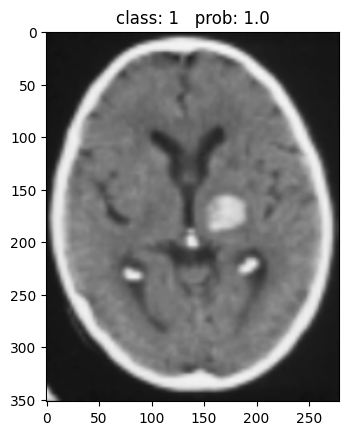

tensor([1.2557e-05, 9.9999e-01])


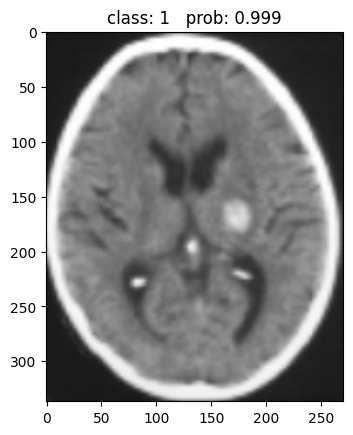

tensor([9.6299e-04, 9.9904e-01])


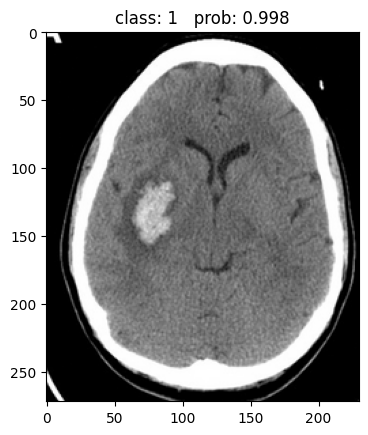

tensor([0.0019, 0.9981])


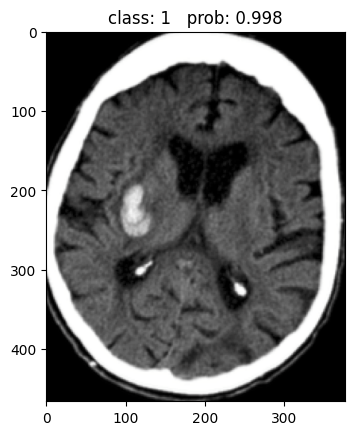

tensor([0.0021, 0.9979])


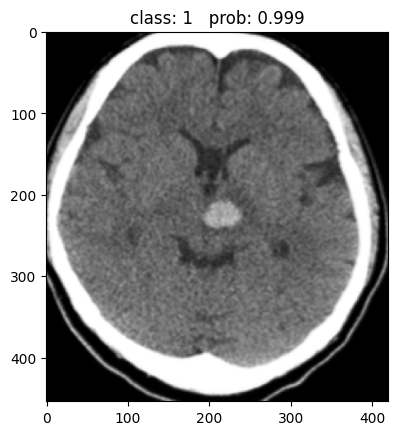

tensor([5.7740e-04, 9.9942e-01])


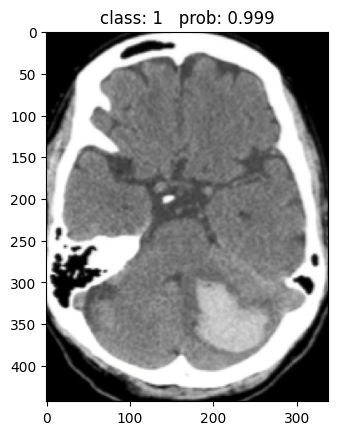

tensor([8.8317e-04, 9.9912e-01])


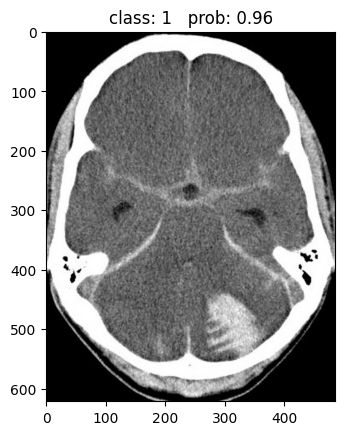

tensor([0.0402, 0.9598])


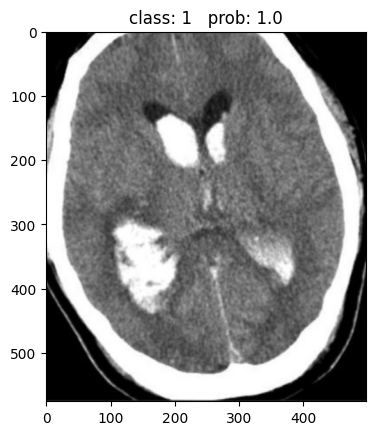

tensor([9.2892e-10, 1.0000e+00])


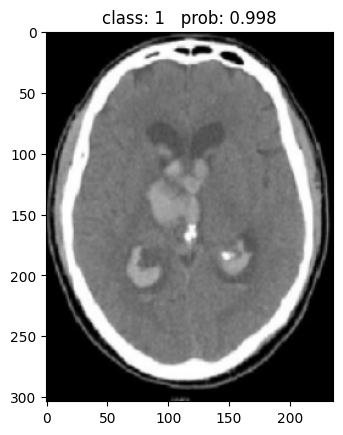

tensor([0.0020, 0.9980])


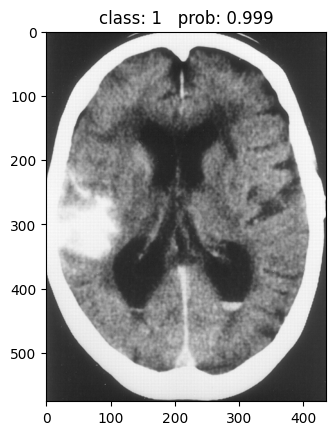

tensor([7.3317e-04, 9.9927e-01])


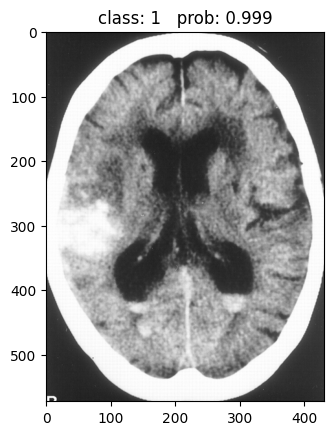

tensor([7.5969e-04, 9.9924e-01])


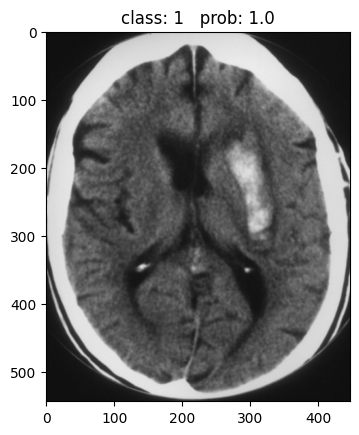

tensor([1.1129e-04, 9.9989e-01])


In [31]:
acc =0
for i in range(0,100):
    img_path = "./input/head_ct/head_ct/"+'%03d' % i+".png"
    img = Image.open(img_path).convert('RGB')

    plt.imshow(img)
    
    # plt.imshow(img)
    # [N, C, H, W]
    img = data_transform(img)
    # expand batch dimension
    img = torch.unsqueeze(img, dim=0)

    model.eval()
    with torch.no_grad():
        # predict class
        output = torch.squeeze(model(img.to(device))).cpu()
        predict = torch.softmax(output, dim=0)
        predict_cla = torch.argmax(predict).numpy()

    print_res = "class: {}   prob: {:.3}".format(class_indict[str(predict_cla)],
                                                 predict[predict_cla].numpy())
    plt.title(print_res)
    plt.show()
    
    print(predict)
    if class_indict[str(predict_cla)]=="1":
        acc+=1


In [14]:
acc

97

In [9]:
import numpy as np
import pandas as pd
import cv2
import glob
import matplotlib.pyplot as plt

In [10]:
label_path = './input/labels.csv'
image_path = './input/head_ct/head_ct'

label_df = pd.read_csv(label_path)
image_files = sorted(glob.glob(image_path + '/*.png'))

In [11]:
labels = np.array(label_df[' hemorrhage'].tolist())
labels

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0])

In [34]:
def prd(setX):
    res=[]
    for img in setX:
        np.reshape(img,(1,128,128))
        img = Image.fromarray(img)
        img = data_transform(img)
        # expand batch dimension
        img = torch.unsqueeze(img, dim=0)

        model.eval()
        with torch.no_grad():
            # predict class
            output = torch.squeeze(model(img.to(device))).cpu()
            predict = torch.softmax(output, dim=0)
            predict_cla = torch.argmax(predict).numpy()
            
        res.append(predict_cla)
    return res

In [35]:
images[0].shape

(128, 128)

In [36]:
prd(images)

RuntimeError: output with shape [1, 224, 224] doesn't match the broadcast shape [3, 224, 224]

In [22]:
def check_accuracy(setX, actual, print_images=True):
    predicted = np.array([int(x[0] > 0.5) for x in prd(setX)])
    if print_images:
        rows = math.ceil(len(predicted) / 10.)
        plt.figure(figsize=(20, 3 * rows))
        for i in range(len(predicted)):
            plt.subplot(rows, 10, i + 1)
            plt.imshow(setX[i])
            plt.title("pred " + str(predicted[i]) + " actual " + str(actual[i]))

    confusion = confusion_matrix(actual, predicted)
    tn, fp, fn, tp = confusion.ravel()
    print("True positive:", tp, ", True negative:", tn,
          ", False positive:", fp, ", False negative:", fn)

    print("Total accuracy:", np.sum(predicted == actual) / len(predicted) * 100., "%")
    return (tn, fp, fn, tp)

In [23]:
check_accuracy(images/255.0, labels, True)

AttributeError: 'Tensor' object has no attribute '__array_interface__'

In [10]:
labels = np.array(label_df[' hemorrhage'].tolist())
labels

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0])

In [7]:
import numpy as np
import pandas as pd
import cv2
import glob
import matplotlib.pyplot as plt
label_path = './input/labels.csv'
image_path = './input/head_ct/head_ct'

label_df = pd.read_csv(label_path)
image_files = sorted(glob.glob(image_path + '/*.png'))

In [28]:
import numpy as np
images = np.array([cv2.imread(file,cv2.IMREAD_GRAYSCALE) for file in image_files])
images=np.array([cv2.resize(image, (128, 128)) for image in images])

/home/ubuntu/miniconda3/envs/env/lib/python3.7/site-packages/ipykernel_launcher.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  


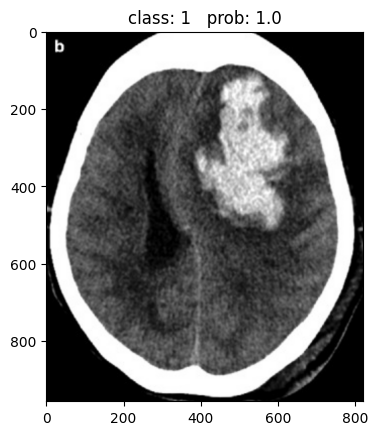

tensor([1.4617e-05, 9.9999e-01])


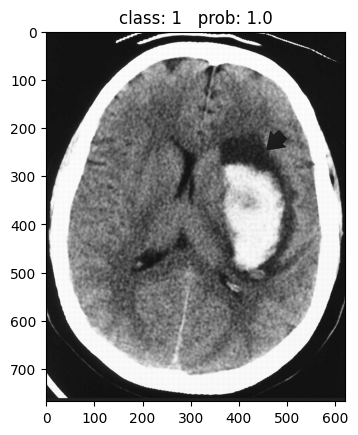

tensor([1.1124e-10, 1.0000e+00])


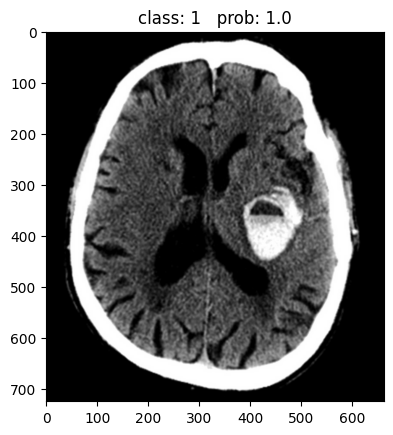

tensor([6.4691e-06, 9.9999e-01])


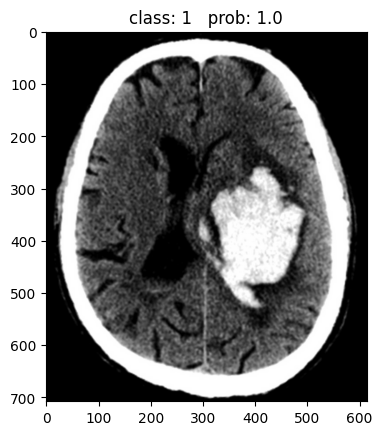

tensor([1.0473e-04, 9.9990e-01])


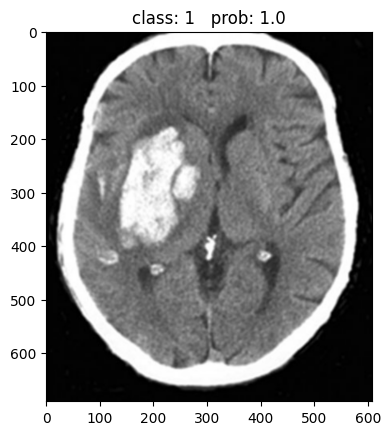

tensor([4.2907e-06, 1.0000e+00])


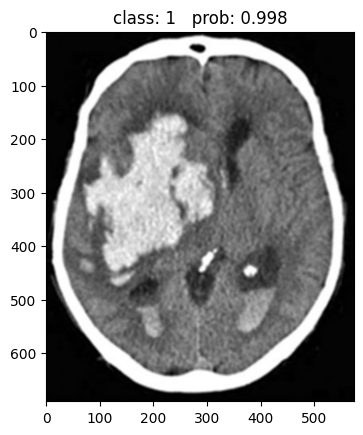

tensor([0.0022, 0.9978])


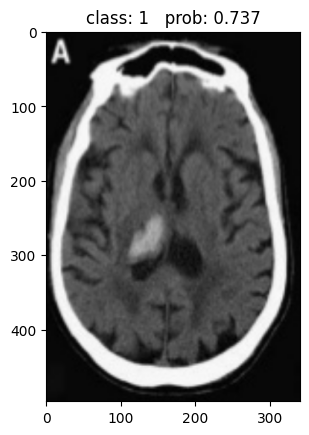

tensor([0.2626, 0.7374])


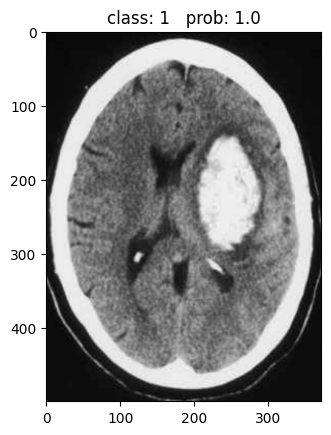

tensor([5.1514e-07, 1.0000e+00])


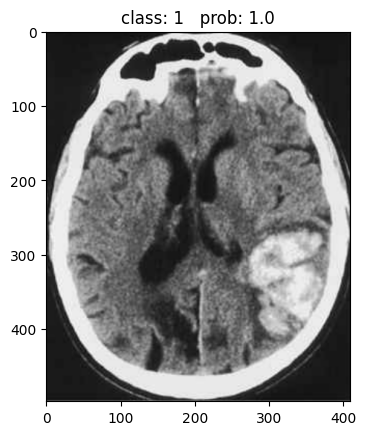

tensor([8.8724e-05, 9.9991e-01])


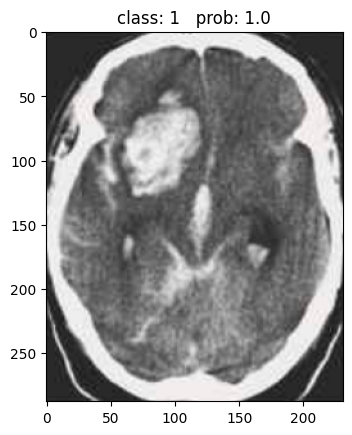

tensor([4.2490e-04, 9.9958e-01])


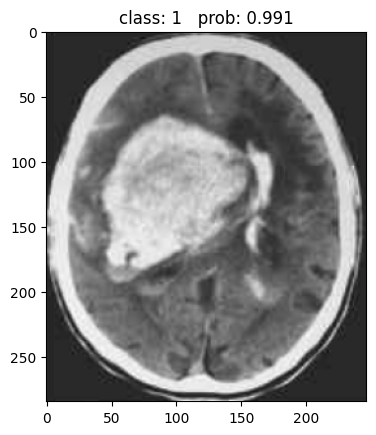

tensor([0.0094, 0.9906])


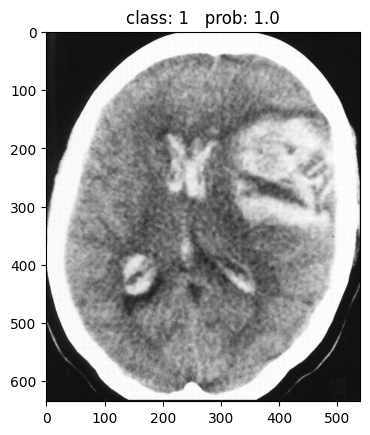

tensor([1.5702e-05, 9.9998e-01])


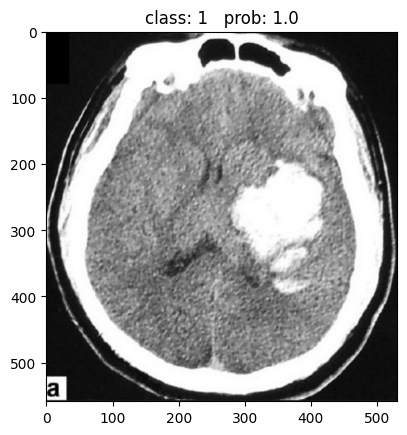

tensor([4.0704e-04, 9.9959e-01])


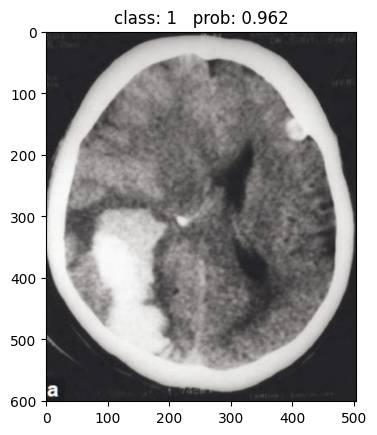

tensor([0.0377, 0.9623])


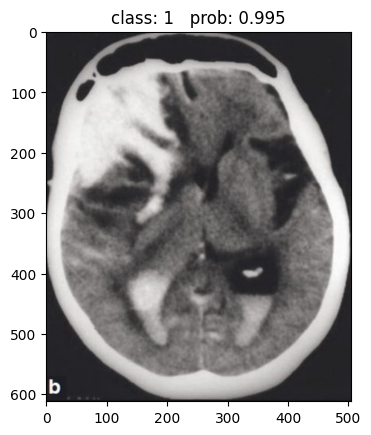

tensor([0.0048, 0.9952])


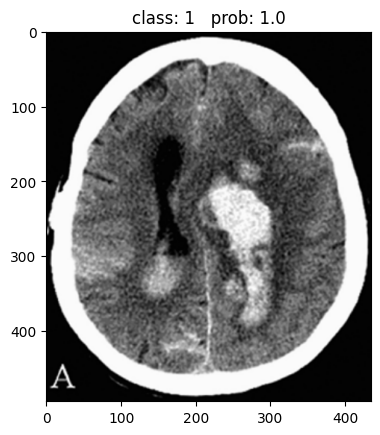

tensor([2.1924e-07, 1.0000e+00])


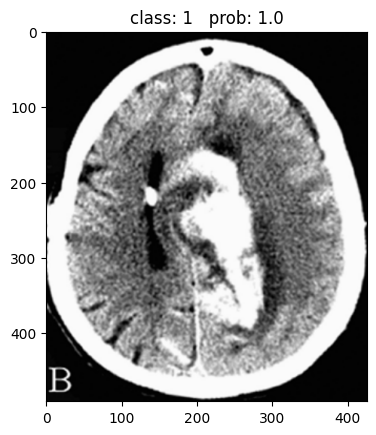

tensor([5.9257e-05, 9.9994e-01])


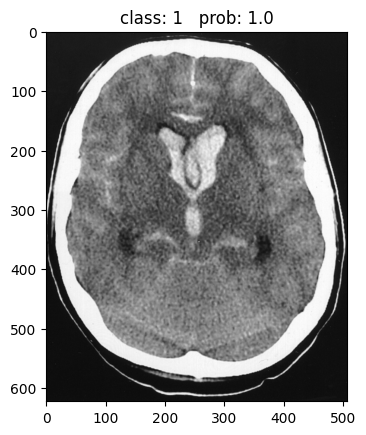

tensor([1.0260e-04, 9.9990e-01])


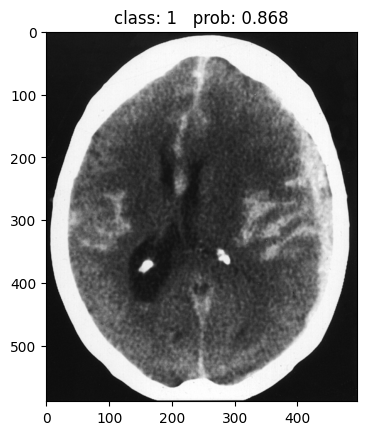

tensor([0.1316, 0.8684])


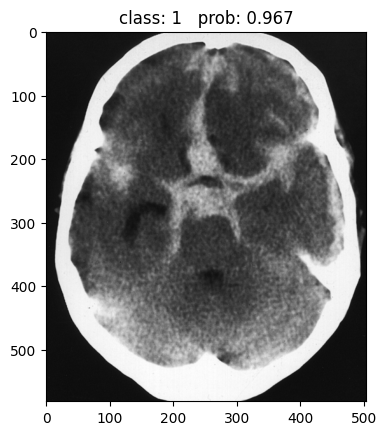

tensor([0.0329, 0.9671])


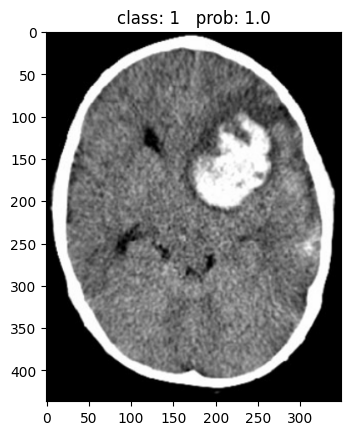

tensor([3.0829e-08, 1.0000e+00])


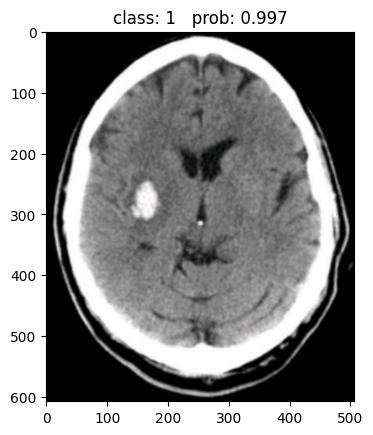

tensor([0.0033, 0.9967])


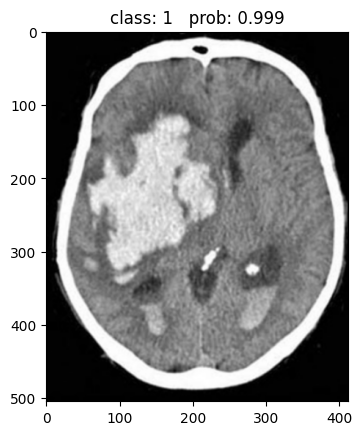

tensor([8.4814e-04, 9.9915e-01])


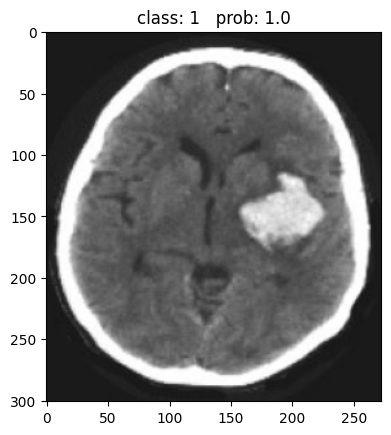

tensor([1.1518e-04, 9.9988e-01])


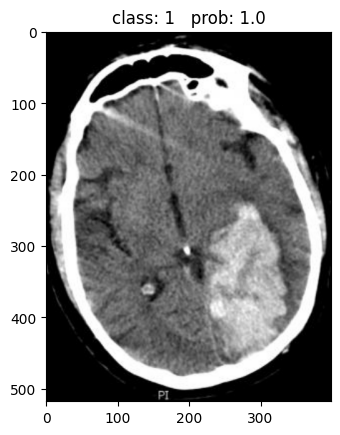

tensor([2.5999e-04, 9.9974e-01])


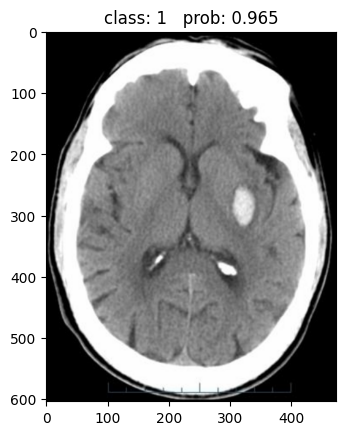

tensor([0.0350, 0.9650])


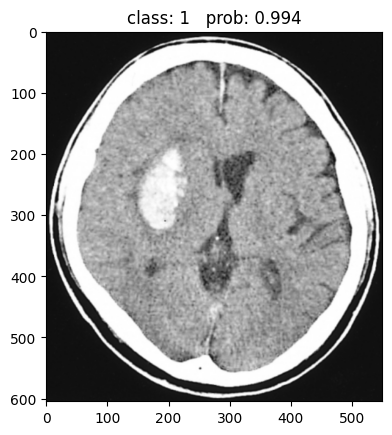

tensor([0.0064, 0.9936])


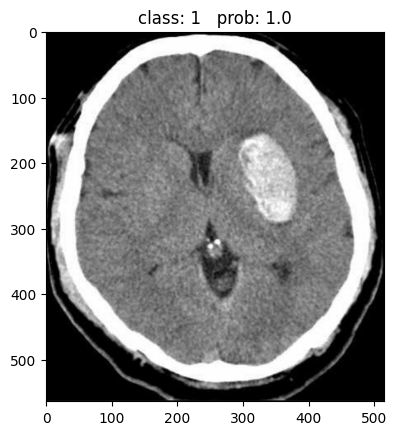

tensor([6.4455e-07, 1.0000e+00])


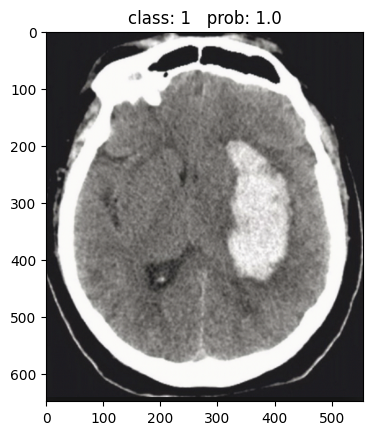

tensor([3.8731e-05, 9.9996e-01])


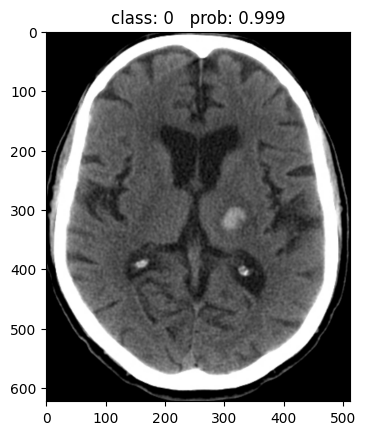

tensor([9.9915e-01, 8.4841e-04])


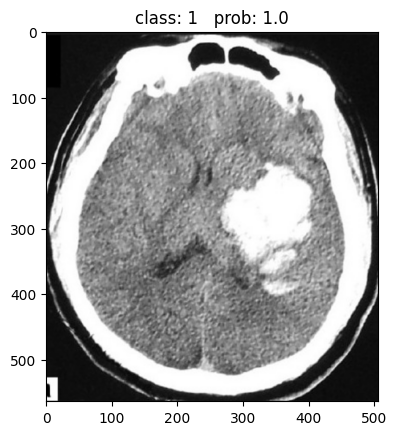

tensor([2.5376e-04, 9.9975e-01])


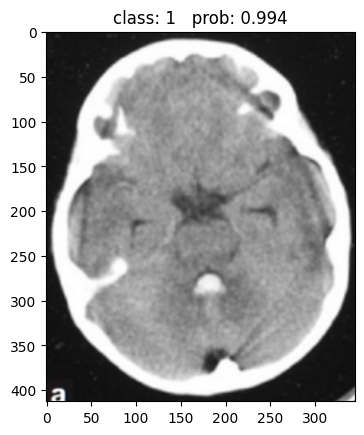

tensor([0.0062, 0.9938])


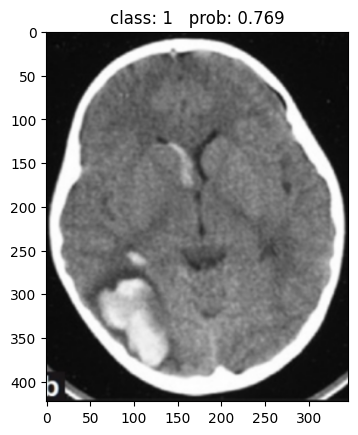

tensor([0.2314, 0.7686])


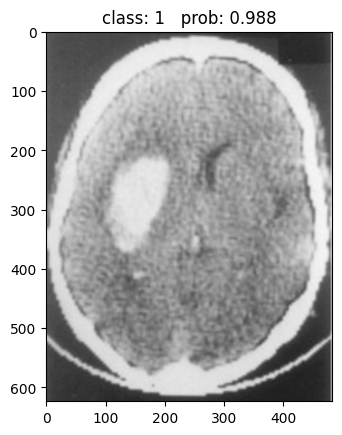

tensor([0.0120, 0.9880])


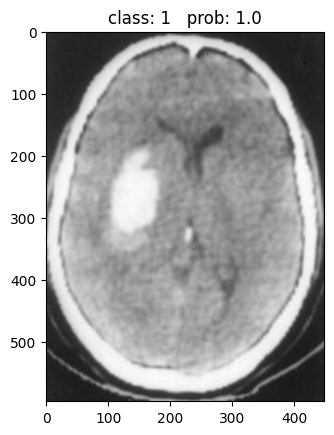

tensor([3.3633e-04, 9.9966e-01])


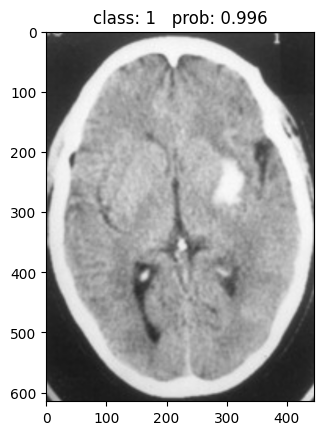

tensor([0.0043, 0.9957])


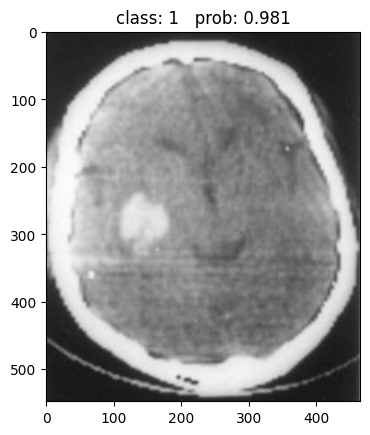

tensor([0.0195, 0.9805])


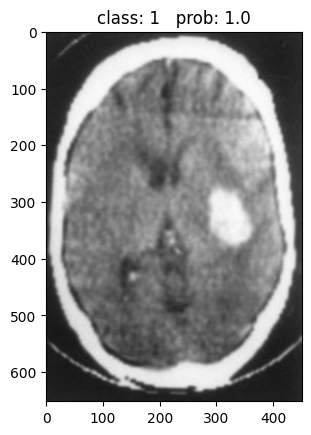

tensor([7.7834e-06, 9.9999e-01])


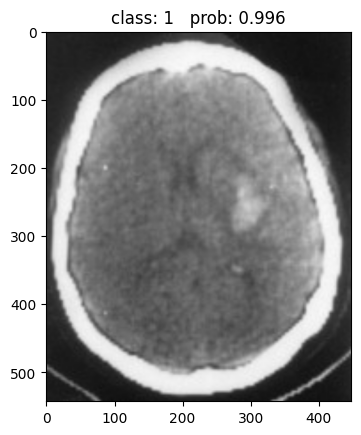

tensor([0.0043, 0.9957])


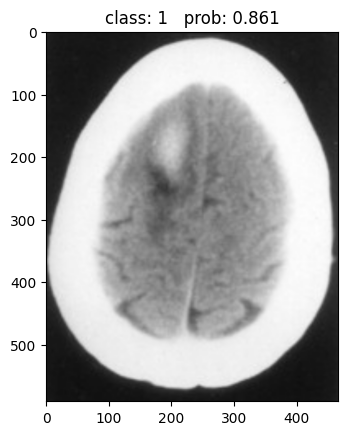

tensor([0.1393, 0.8607])


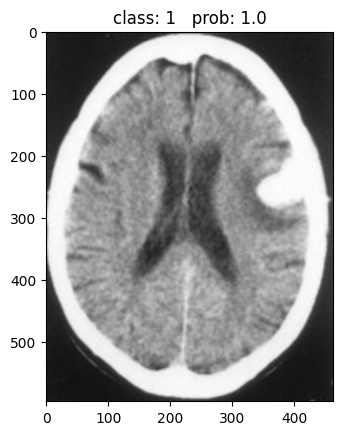

tensor([2.8721e-04, 9.9971e-01])


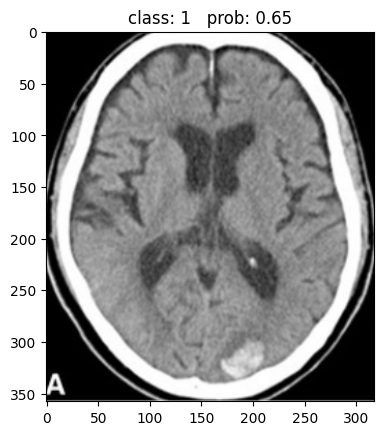

tensor([0.3497, 0.6503])


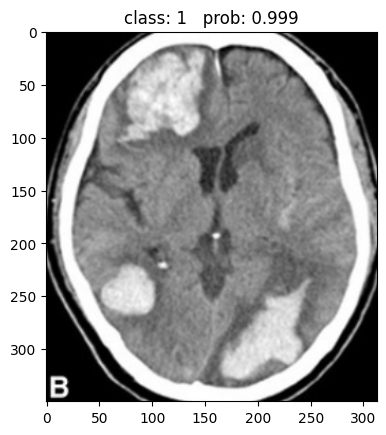

tensor([9.0296e-04, 9.9910e-01])


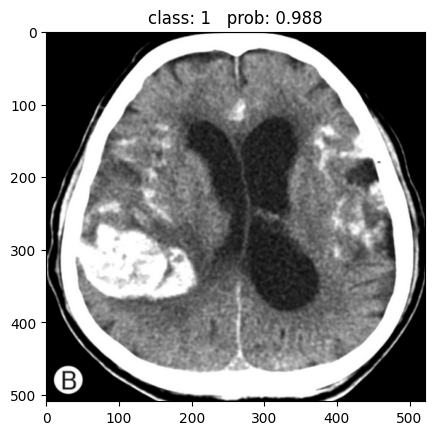

tensor([0.0121, 0.9879])


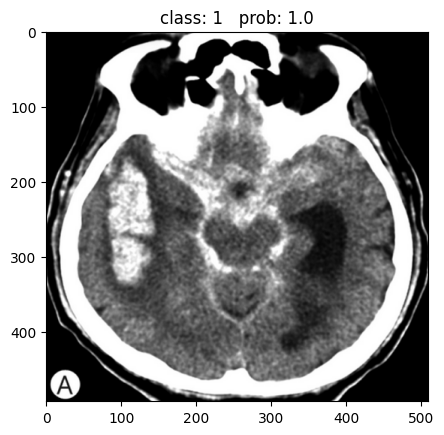

tensor([1.6728e-04, 9.9983e-01])


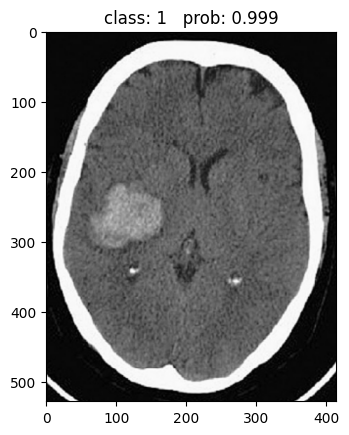

tensor([0.0014, 0.9986])


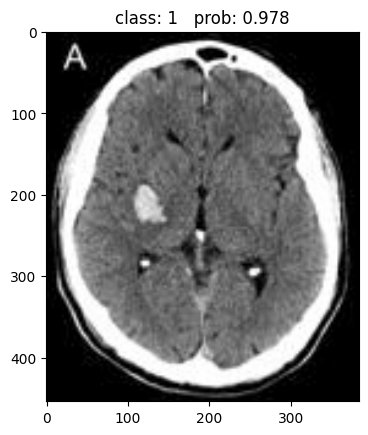

tensor([0.0217, 0.9783])


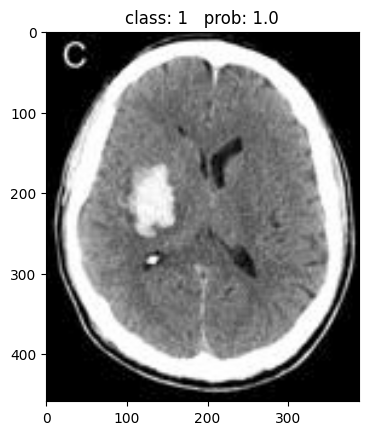

tensor([5.7350e-06, 9.9999e-01])


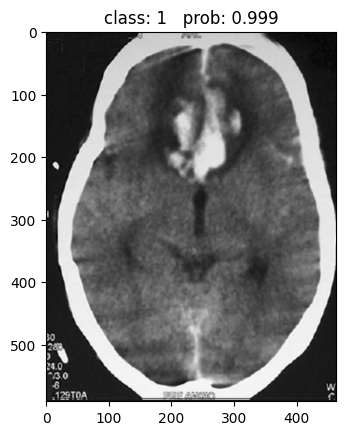

tensor([0.0014, 0.9986])


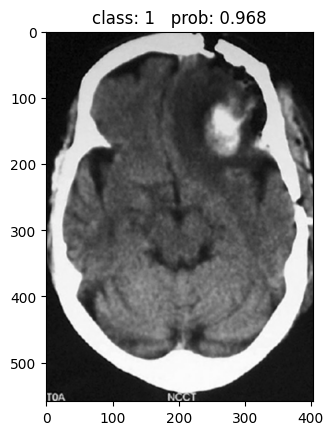

tensor([0.0317, 0.9683])


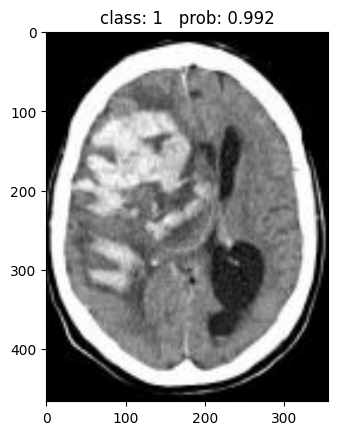

tensor([0.0077, 0.9923])


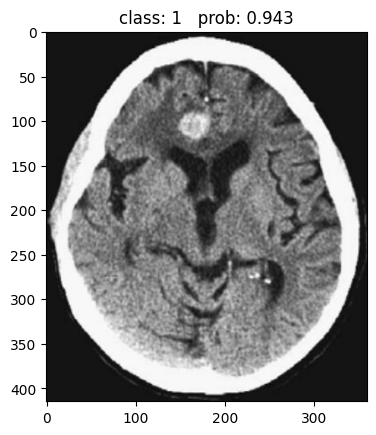

tensor([0.0573, 0.9427])


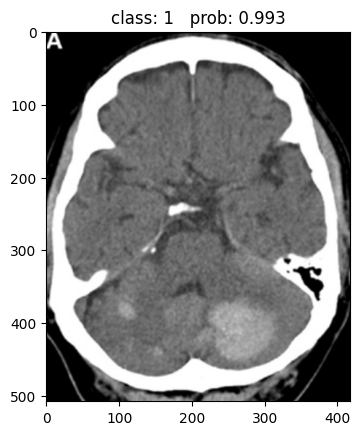

tensor([0.0073, 0.9927])


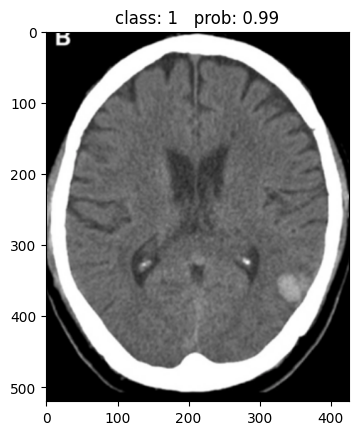

tensor([0.0096, 0.9904])


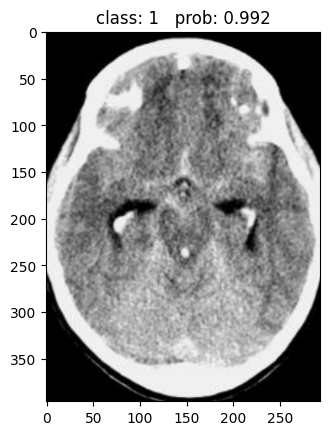

tensor([0.0079, 0.9921])


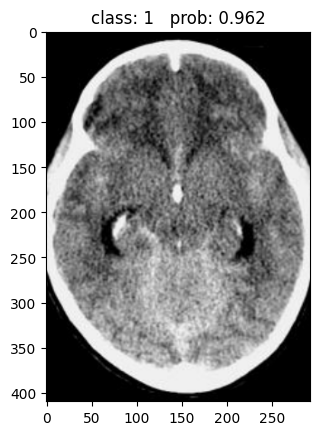

tensor([0.0379, 0.9621])


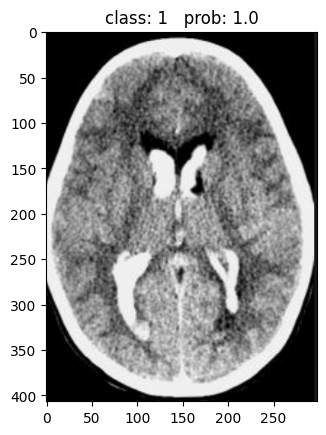

tensor([4.2269e-05, 9.9996e-01])


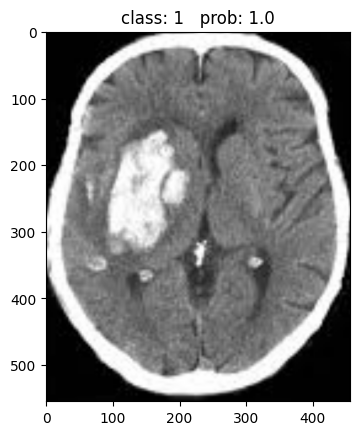

tensor([7.3795e-06, 9.9999e-01])


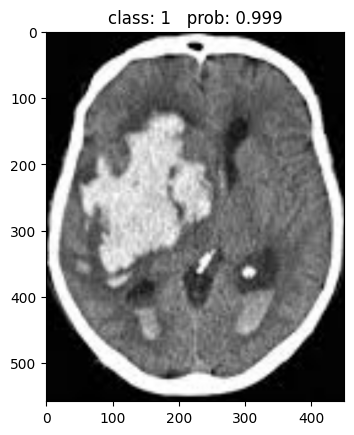

tensor([0.0013, 0.9987])


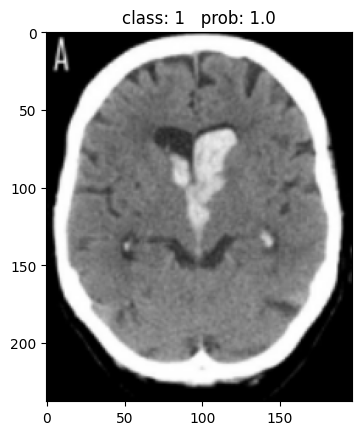

tensor([1.2967e-05, 9.9999e-01])


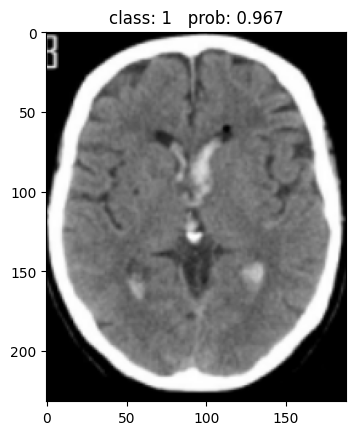

tensor([0.0332, 0.9668])


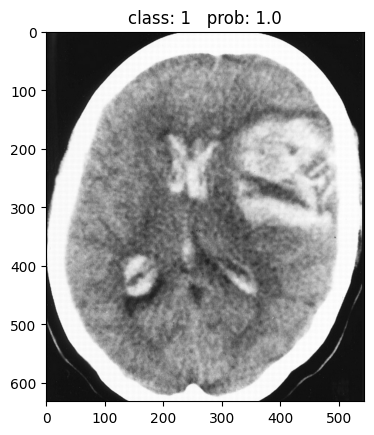

tensor([1.9841e-05, 9.9998e-01])


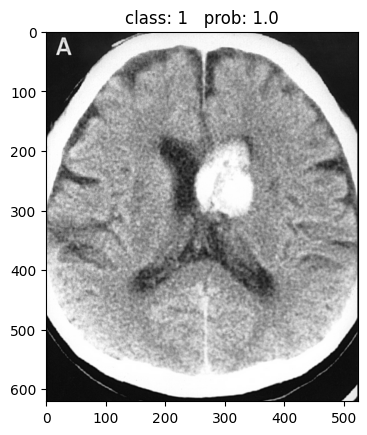

tensor([7.1513e-08, 1.0000e+00])


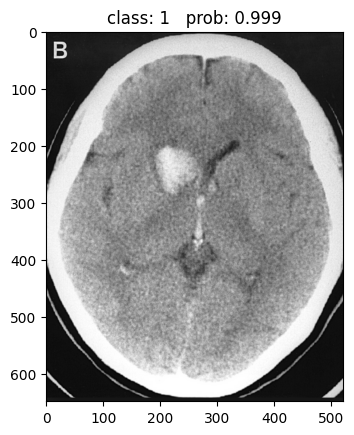

tensor([5.1525e-04, 9.9948e-01])


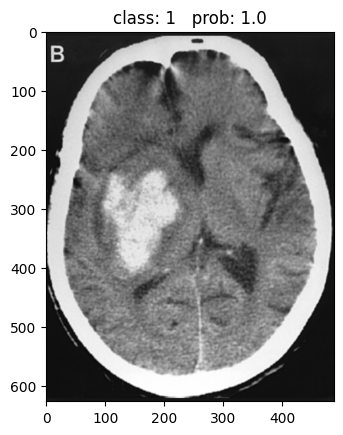

tensor([5.4044e-05, 9.9995e-01])


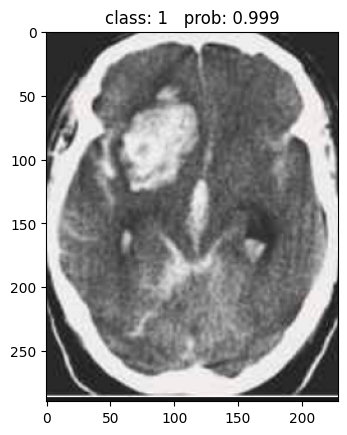

tensor([6.0327e-04, 9.9940e-01])


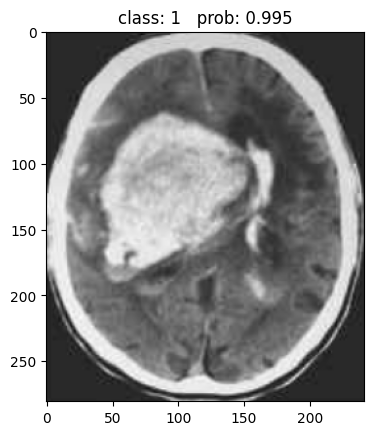

tensor([0.0053, 0.9947])


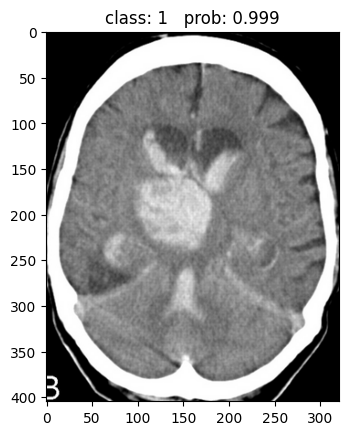

tensor([6.7093e-04, 9.9933e-01])


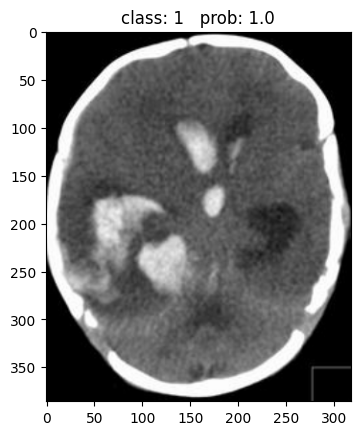

tensor([2.0481e-05, 9.9998e-01])


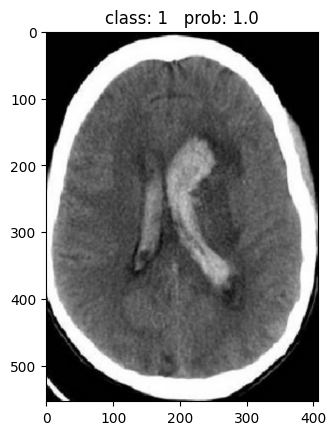

tensor([1.1777e-04, 9.9988e-01])


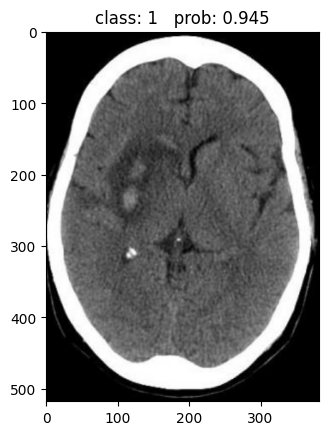

tensor([0.0552, 0.9448])


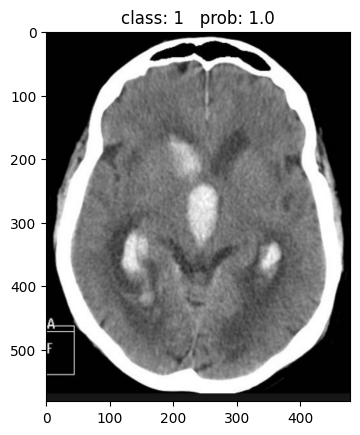

tensor([1.1812e-05, 9.9999e-01])


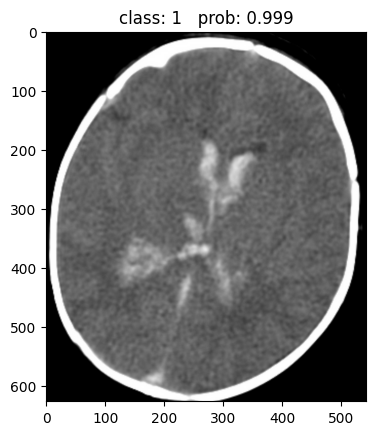

tensor([7.9189e-04, 9.9921e-01])


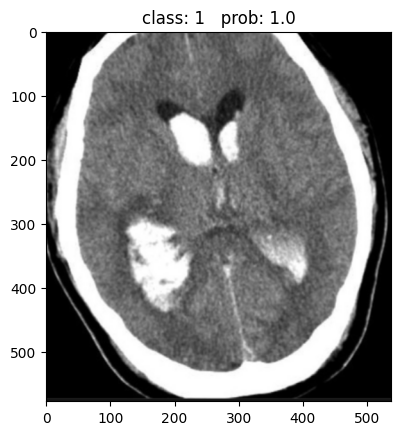

tensor([4.5775e-09, 1.0000e+00])


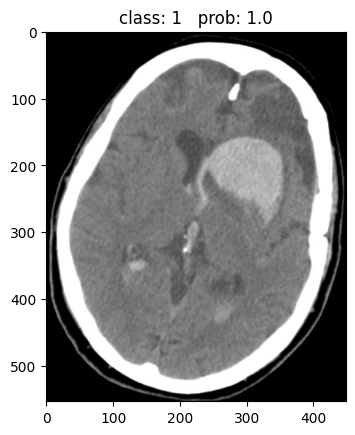

tensor([3.3059e-04, 9.9967e-01])


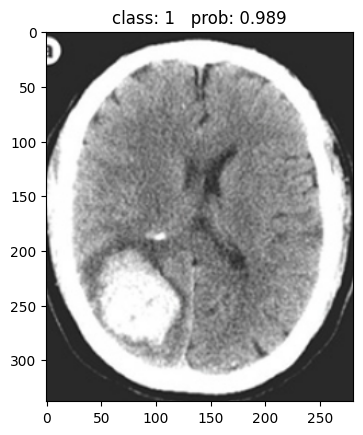

tensor([0.0111, 0.9889])


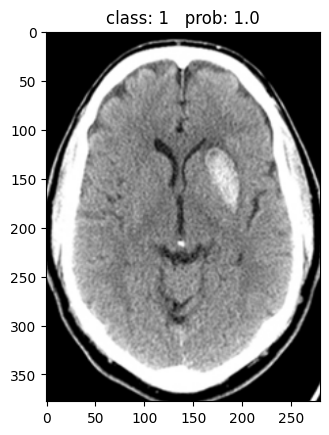

tensor([1.6080e-05, 9.9998e-01])


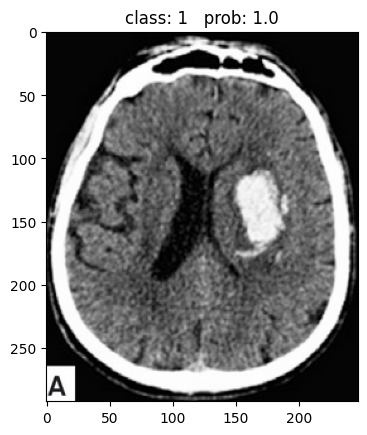

tensor([1.9099e-10, 1.0000e+00])


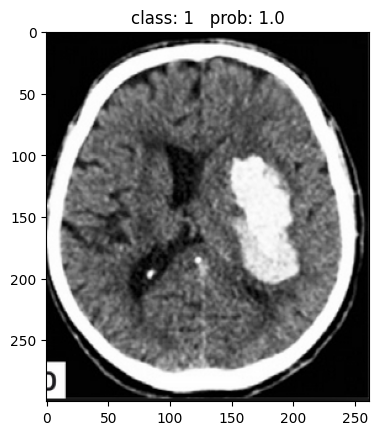

tensor([1.0633e-08, 1.0000e+00])


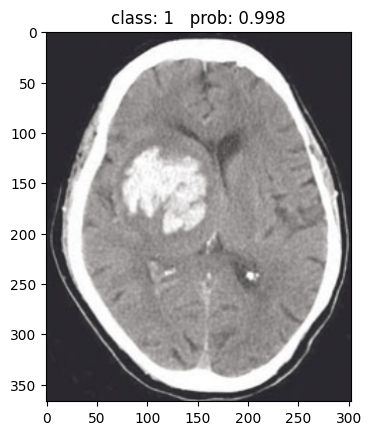

tensor([0.0019, 0.9981])


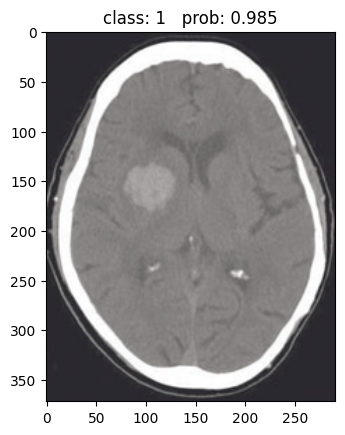

tensor([0.0149, 0.9851])


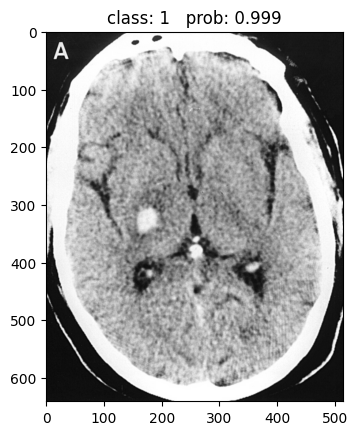

tensor([9.1378e-04, 9.9909e-01])


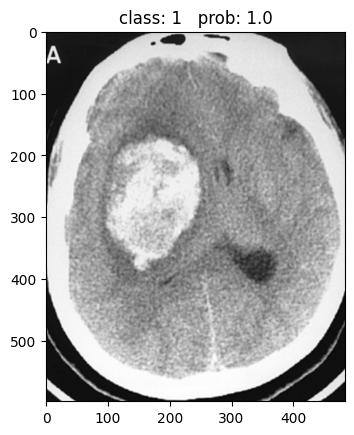

tensor([4.2044e-04, 9.9958e-01])


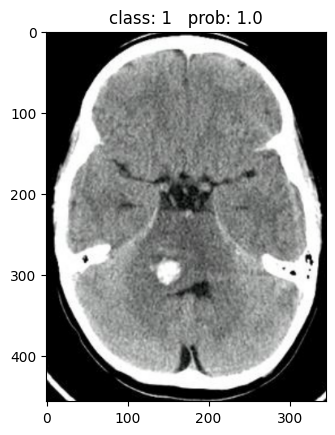

tensor([4.4237e-05, 9.9996e-01])


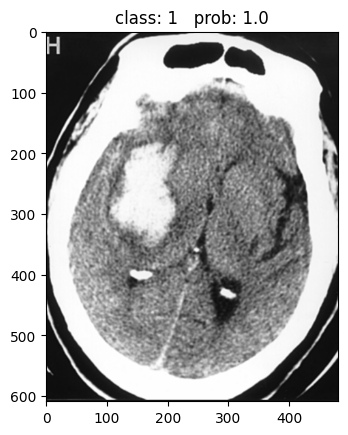

tensor([4.3610e-05, 9.9996e-01])


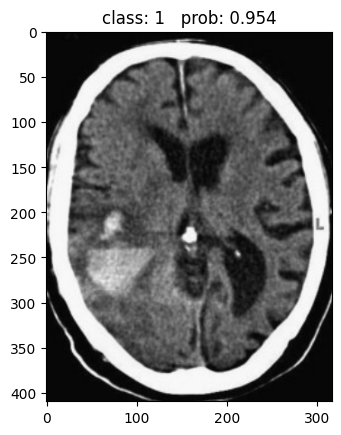

tensor([0.0456, 0.9544])


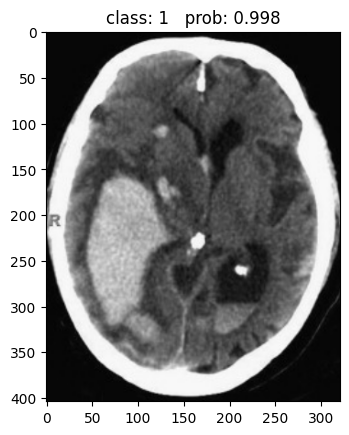

tensor([0.0019, 0.9981])


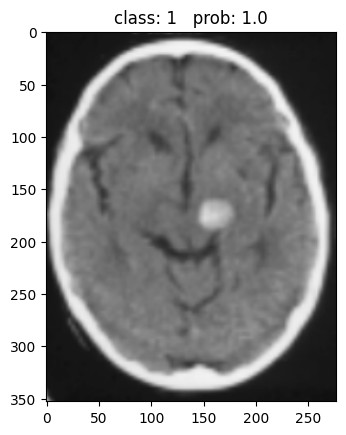

tensor([8.5532e-05, 9.9991e-01])


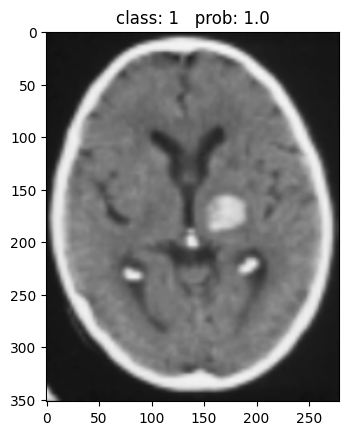

tensor([1.2557e-05, 9.9999e-01])


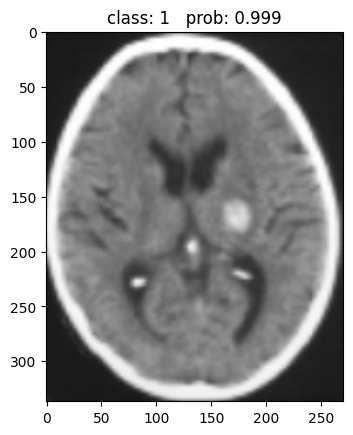

tensor([9.6299e-04, 9.9904e-01])


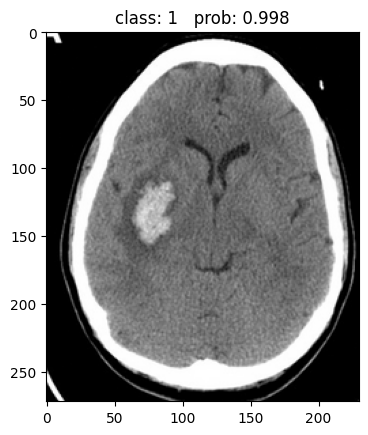

tensor([0.0019, 0.9981])


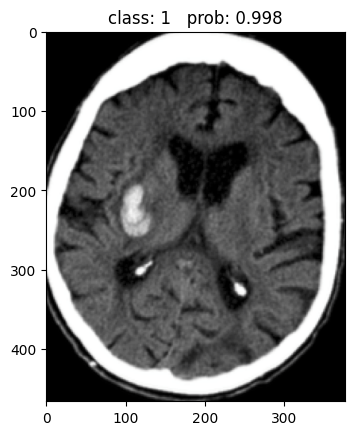

tensor([0.0021, 0.9979])


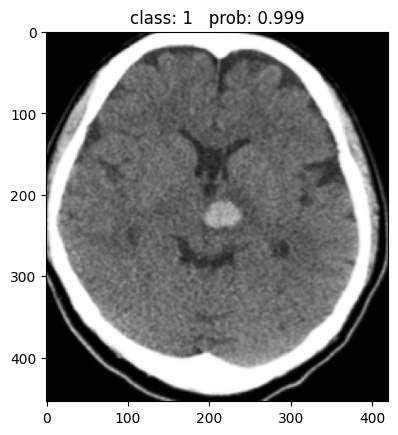

tensor([5.7889e-04, 9.9942e-01])


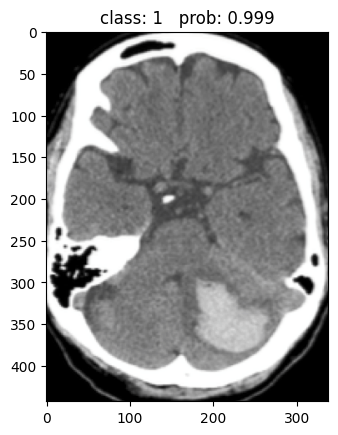

tensor([9.0484e-04, 9.9910e-01])


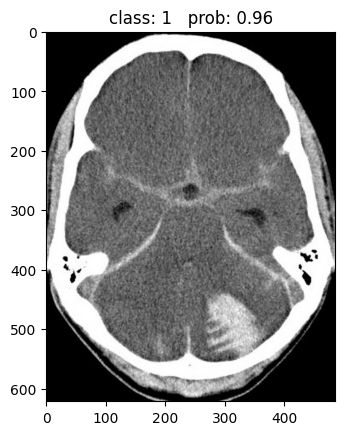

tensor([0.0402, 0.9598])


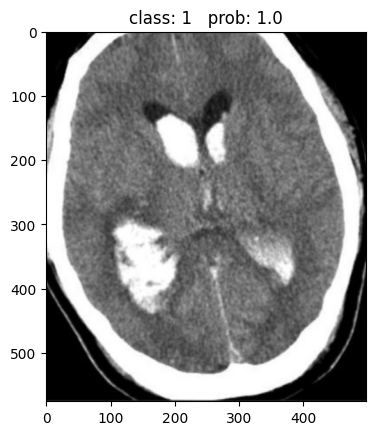

tensor([9.2892e-10, 1.0000e+00])


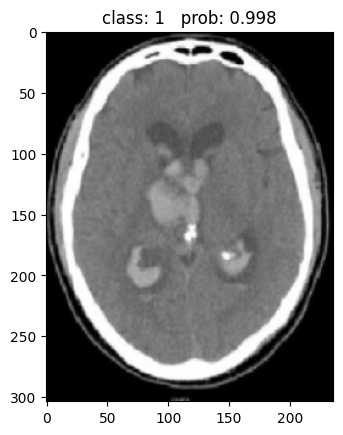

tensor([0.0020, 0.9980])


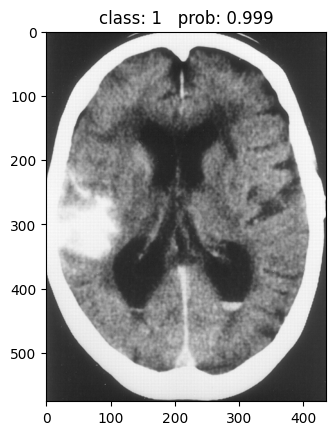

tensor([7.3317e-04, 9.9927e-01])


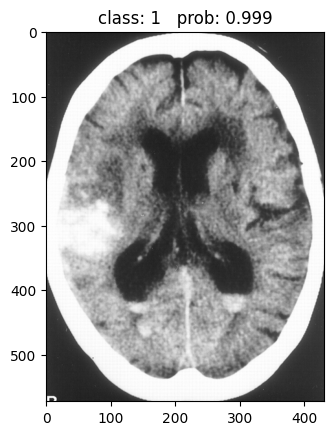

tensor([7.5969e-04, 9.9924e-01])


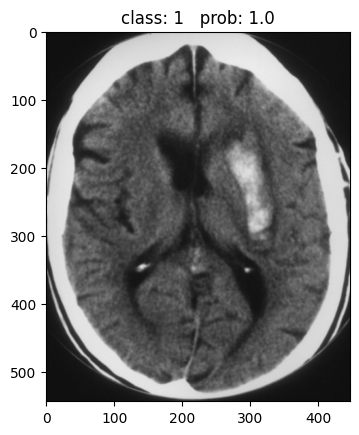

tensor([1.1129e-04, 9.9989e-01])


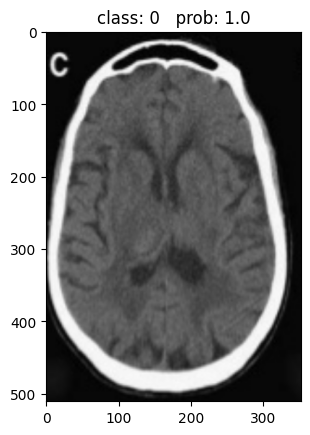

tensor([9.9969e-01, 3.0959e-04])


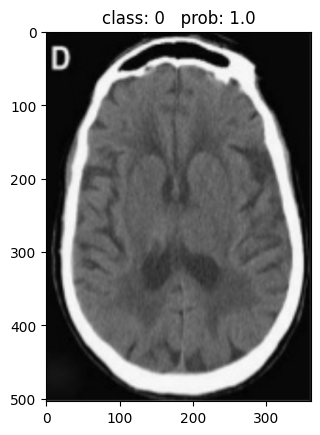

tensor([9.9972e-01, 2.7678e-04])


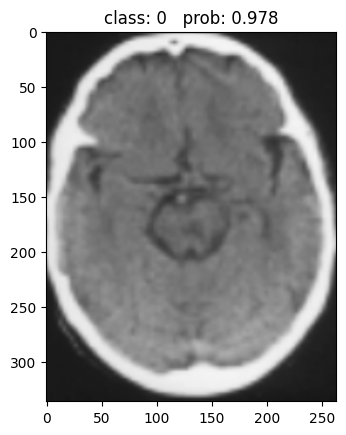

tensor([0.9784, 0.0216])


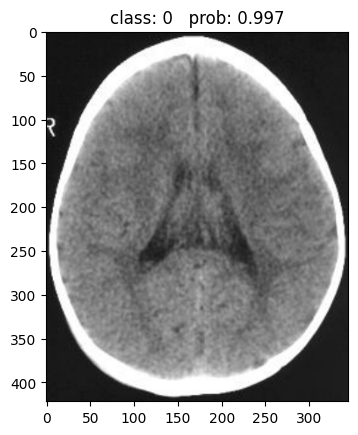

tensor([0.9972, 0.0028])


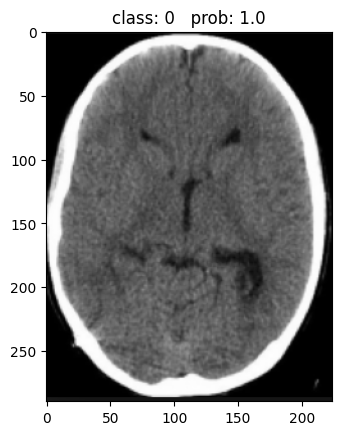

tensor([9.9995e-01, 4.5904e-05])


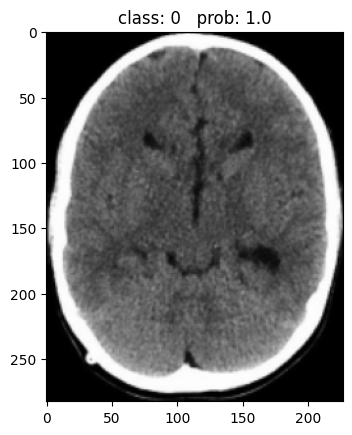

tensor([9.9996e-01, 4.0176e-05])


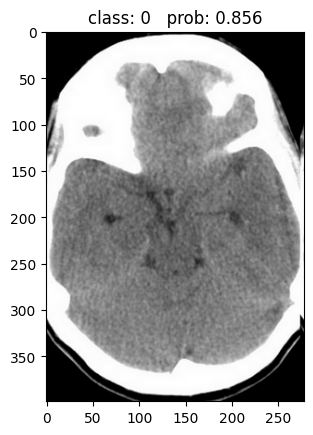

tensor([0.8560, 0.1440])


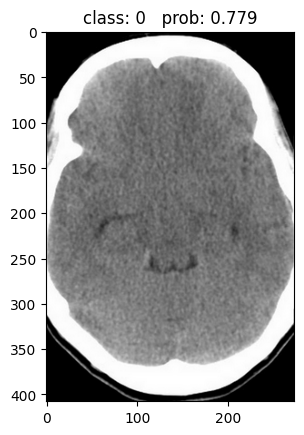

tensor([0.7790, 0.2210])


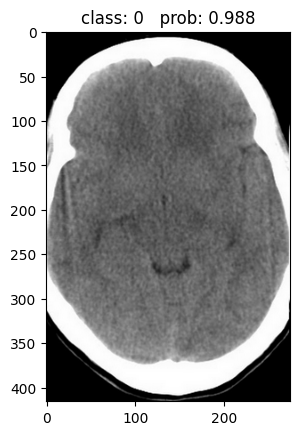

tensor([0.9885, 0.0115])


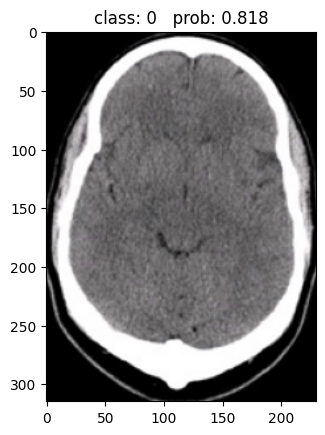

tensor([0.8177, 0.1823])


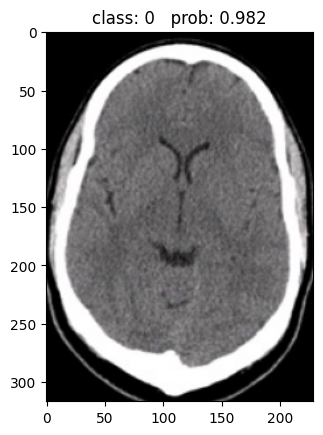

tensor([0.9823, 0.0177])


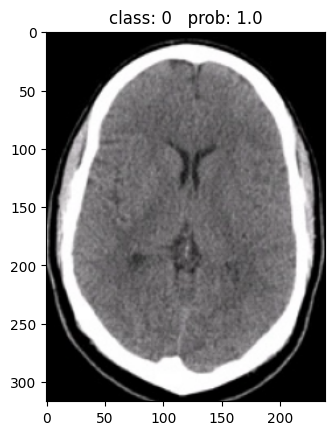

tensor([9.9983e-01, 1.7351e-04])


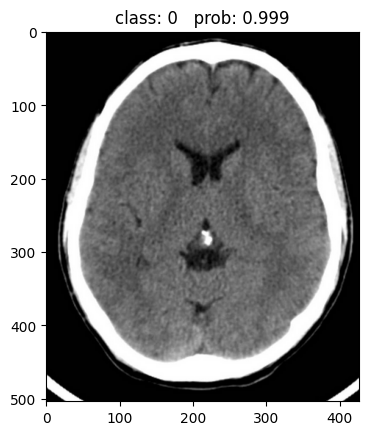

tensor([0.9988, 0.0012])


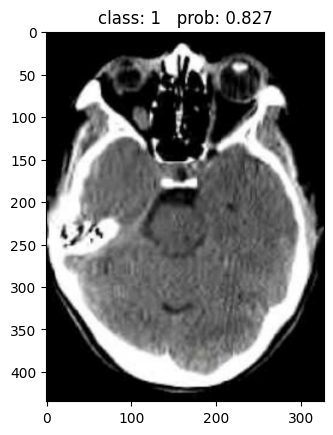

tensor([0.1726, 0.8274])


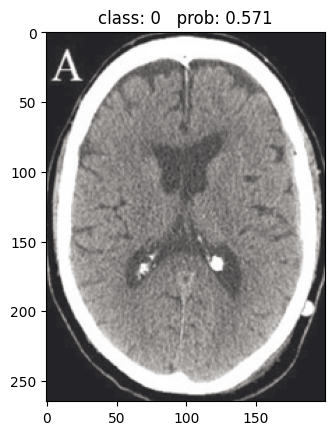

tensor([0.5711, 0.4289])


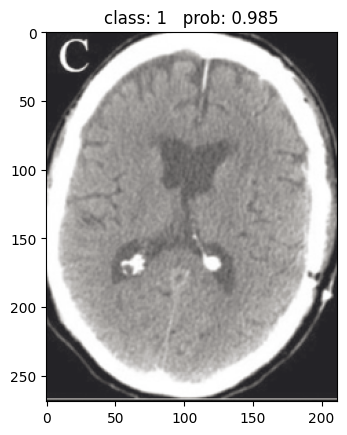

tensor([0.0150, 0.9850])


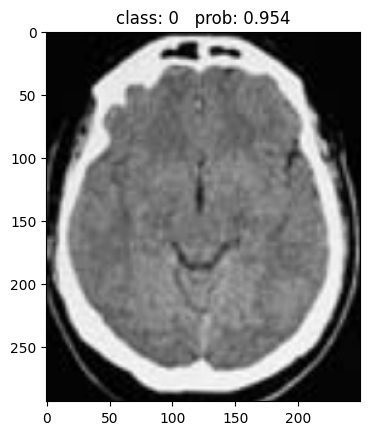

tensor([0.9540, 0.0460])


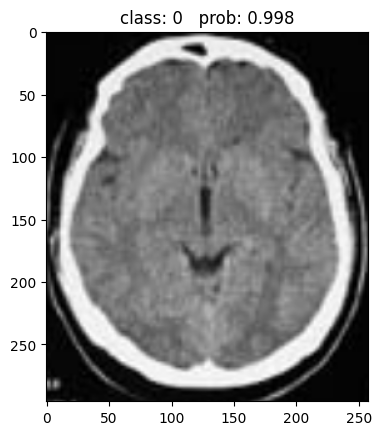

tensor([0.9976, 0.0024])


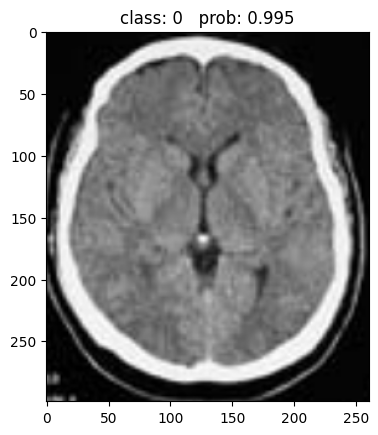

tensor([0.9954, 0.0046])


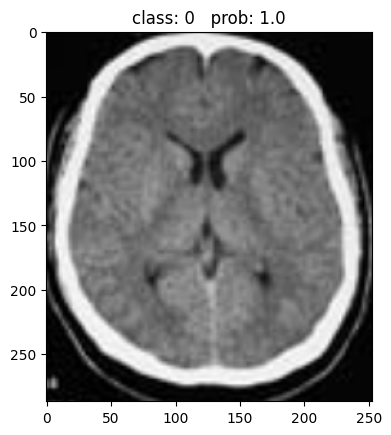

tensor([9.9991e-01, 8.8452e-05])


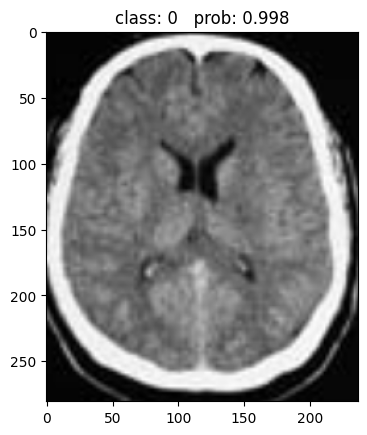

tensor([0.9983, 0.0017])


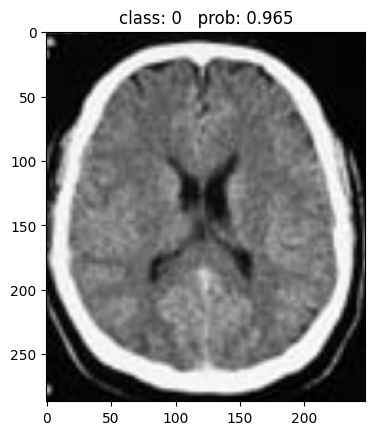

tensor([0.9652, 0.0348])


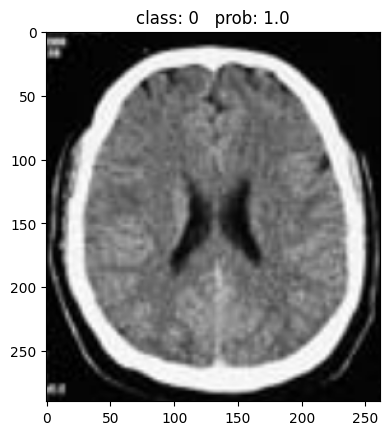

tensor([9.9995e-01, 5.1777e-05])


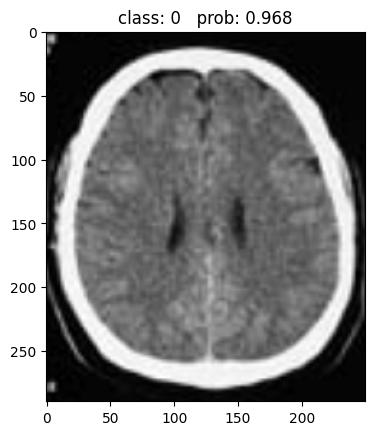

tensor([0.9681, 0.0319])


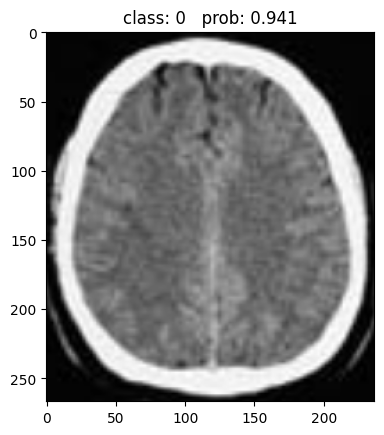

tensor([0.9410, 0.0590])


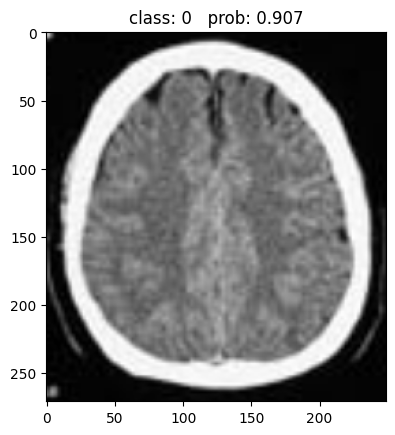

tensor([0.9070, 0.0930])


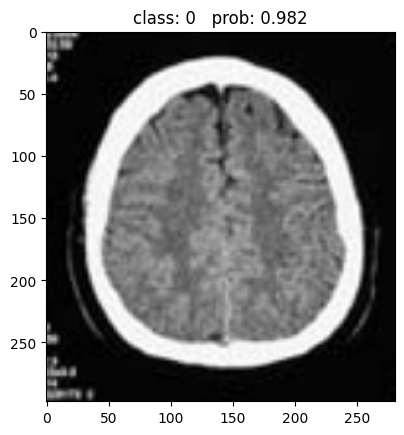

tensor([0.9821, 0.0179])


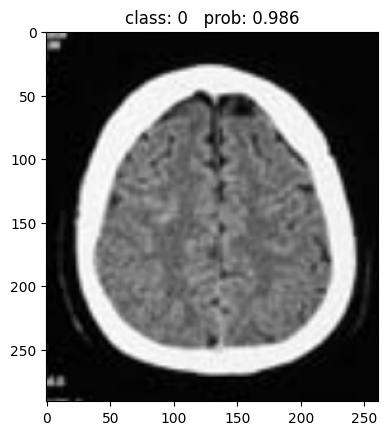

tensor([0.9864, 0.0136])


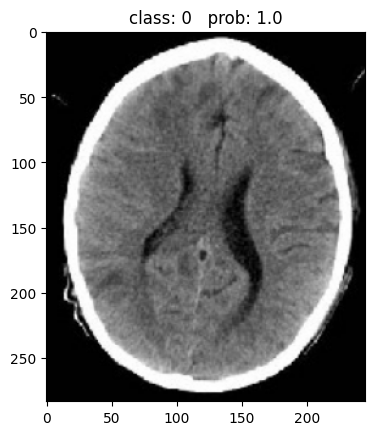

tensor([1.0000e+00, 8.6127e-07])


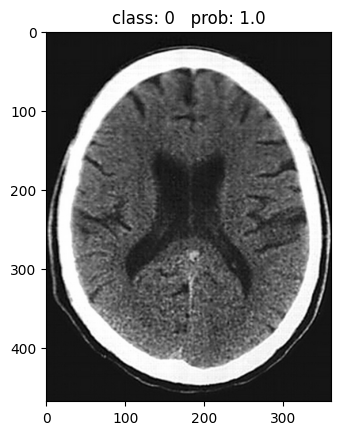

tensor([9.9982e-01, 1.8095e-04])


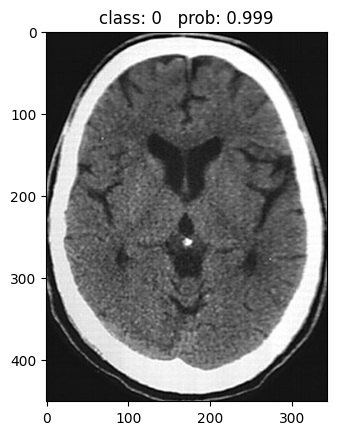

tensor([9.9925e-01, 7.5424e-04])


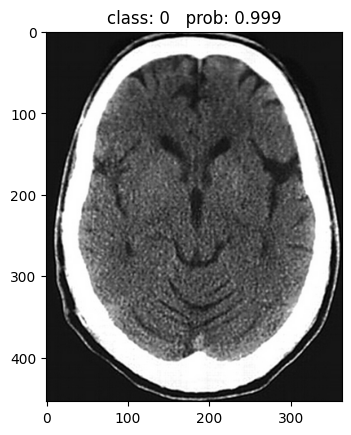

tensor([9.9924e-01, 7.6407e-04])


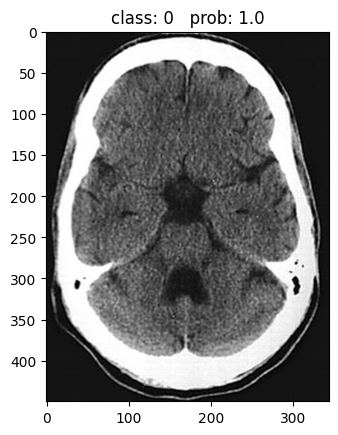

tensor([9.9958e-01, 4.2139e-04])


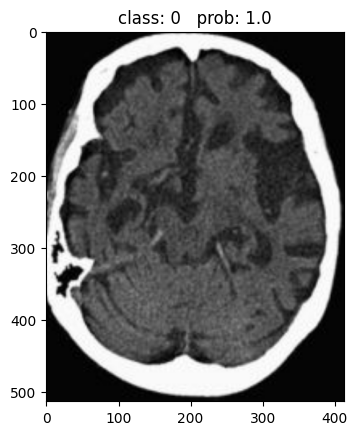

tensor([9.9983e-01, 1.6547e-04])


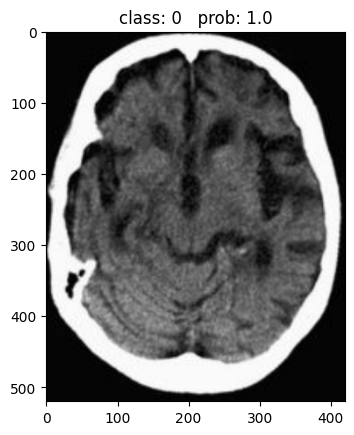

tensor([9.9991e-01, 8.9670e-05])


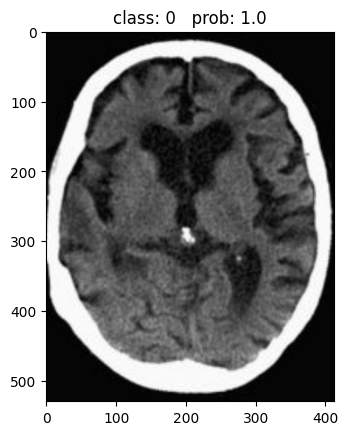

tensor([9.9951e-01, 4.9025e-04])


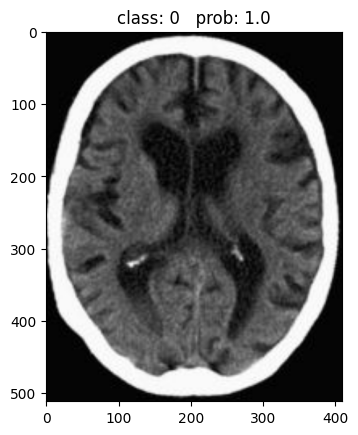

tensor([9.9993e-01, 6.6188e-05])


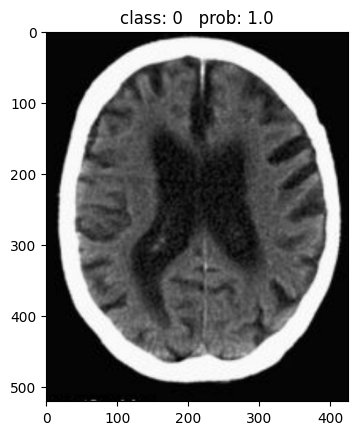

tensor([9.9988e-01, 1.1716e-04])


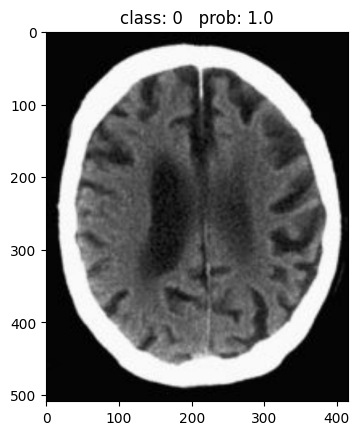

tensor([9.9973e-01, 2.6553e-04])


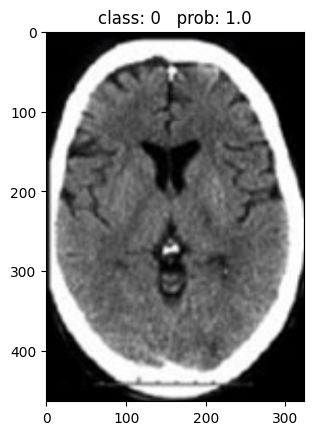

tensor([9.9997e-01, 3.2697e-05])


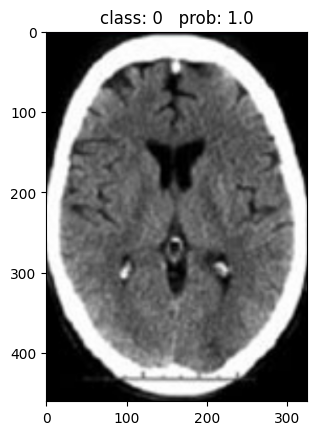

tensor([9.9992e-01, 7.7065e-05])


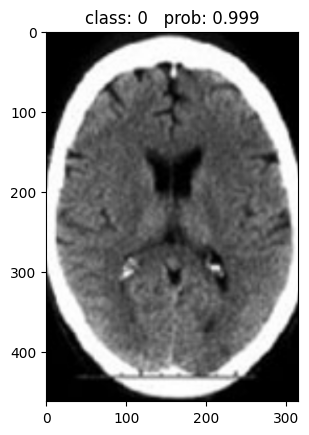

tensor([9.9934e-01, 6.6291e-04])


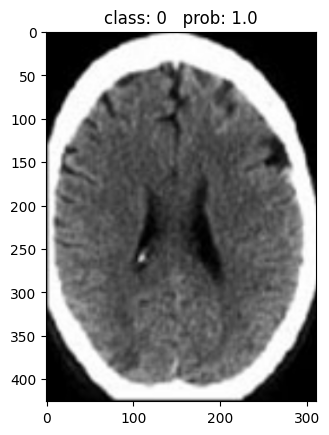

tensor([9.9998e-01, 2.4826e-05])


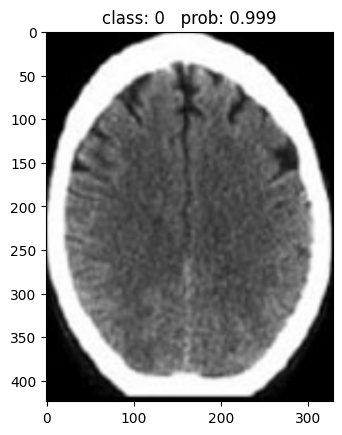

tensor([0.9989, 0.0011])


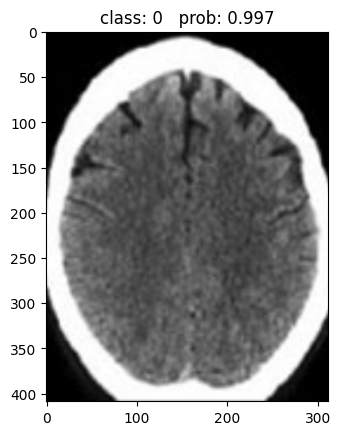

tensor([0.9973, 0.0027])


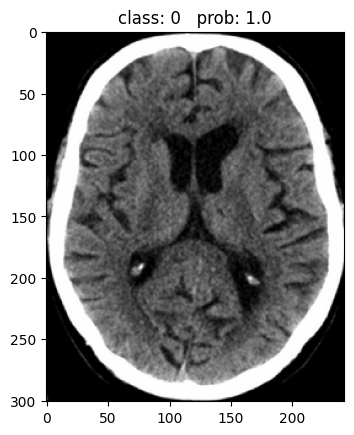

tensor([1.0000e+00, 3.5007e-07])


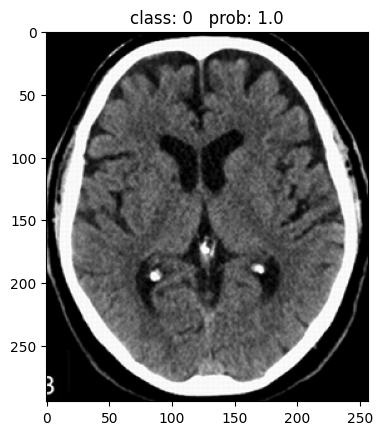

tensor([9.9999e-01, 9.8492e-06])


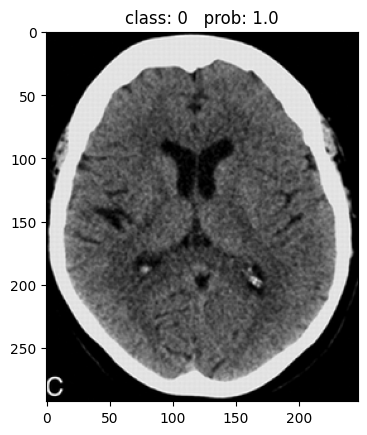

tensor([9.9999e-01, 1.0078e-05])


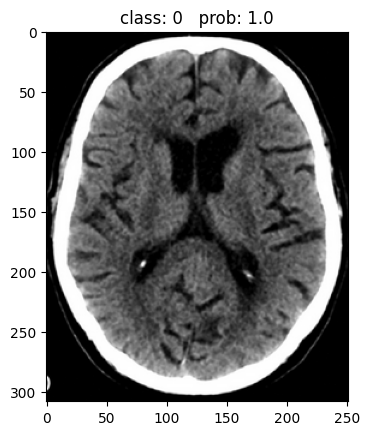

tensor([1.0000e+00, 2.0119e-06])


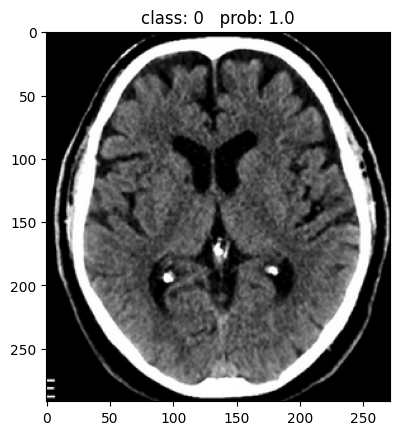

tensor([1.0000e+00, 3.0046e-06])


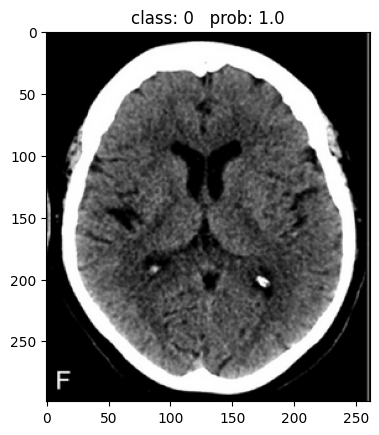

tensor([9.9999e-01, 1.2499e-05])


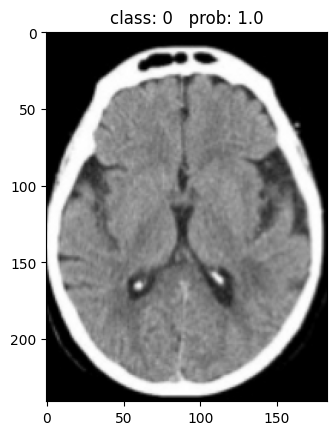

tensor([9.9995e-01, 5.4856e-05])


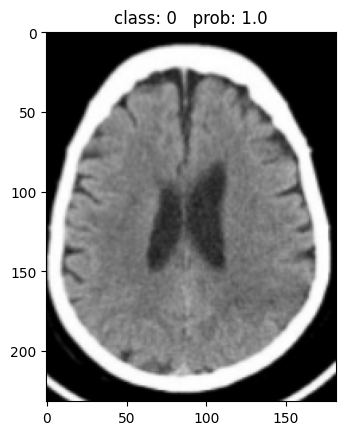

tensor([9.9993e-01, 6.7506e-05])


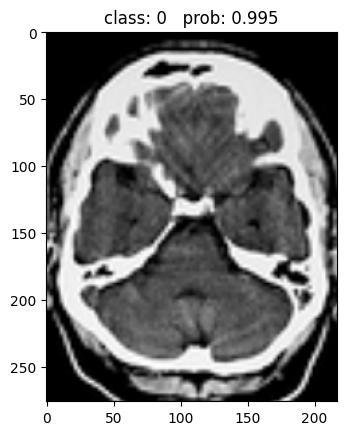

tensor([0.9952, 0.0048])


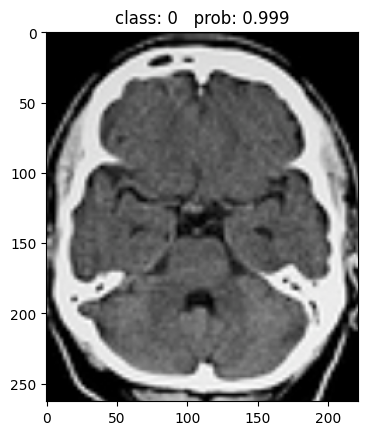

tensor([9.9946e-01, 5.4085e-04])


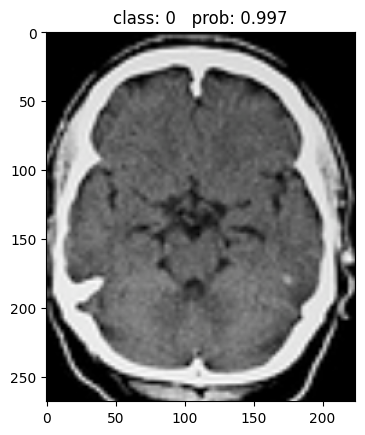

tensor([0.9974, 0.0026])


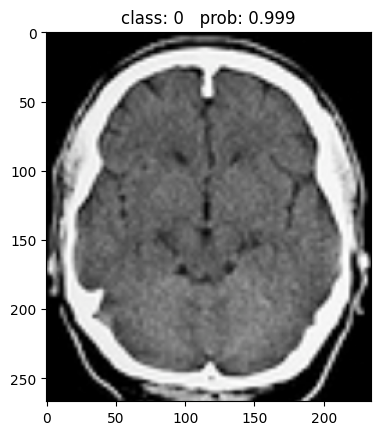

tensor([0.9988, 0.0012])


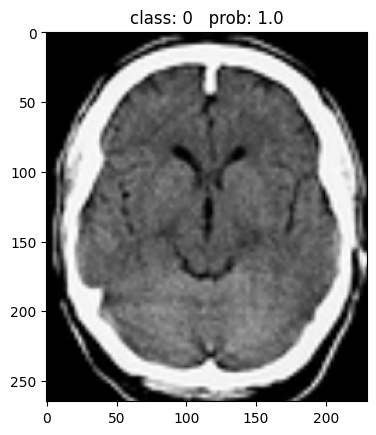

tensor([9.9966e-01, 3.4048e-04])


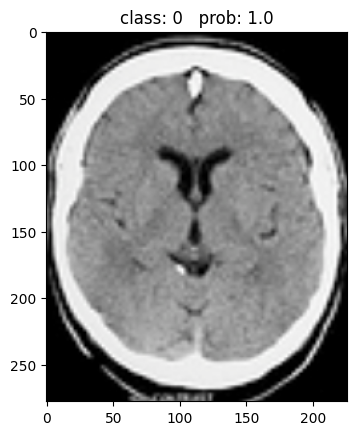

tensor([1.0000e+00, 1.8534e-06])


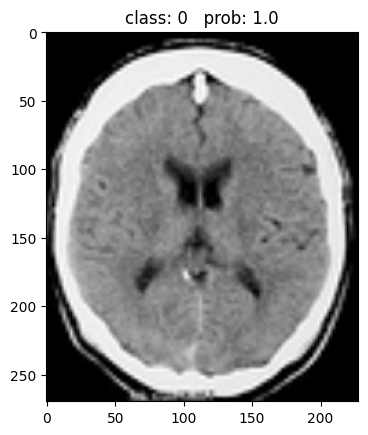

tensor([9.9997e-01, 2.8609e-05])


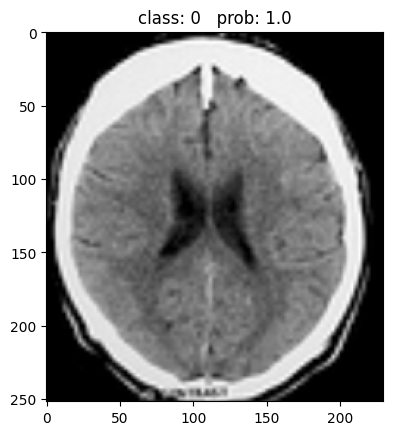

tensor([9.9999e-01, 1.2578e-05])


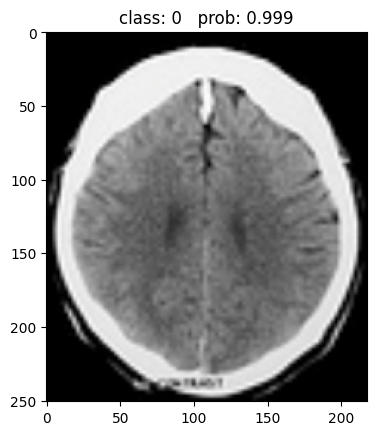

tensor([9.9931e-01, 6.9422e-04])


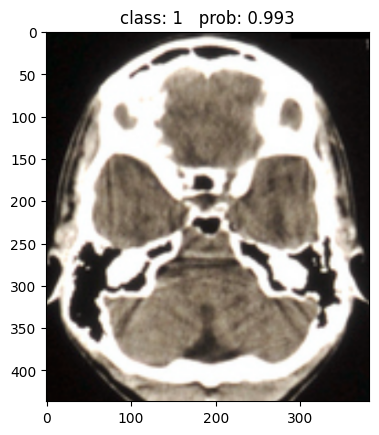

tensor([0.0066, 0.9934])


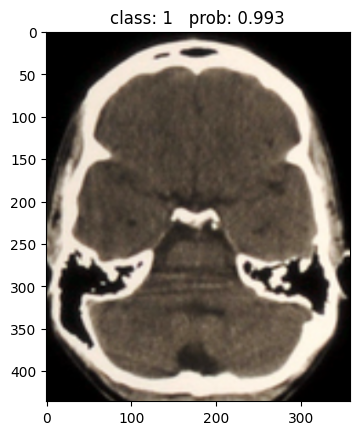

tensor([0.0069, 0.9931])


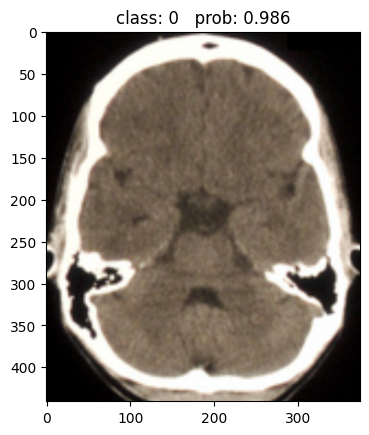

tensor([0.9864, 0.0136])


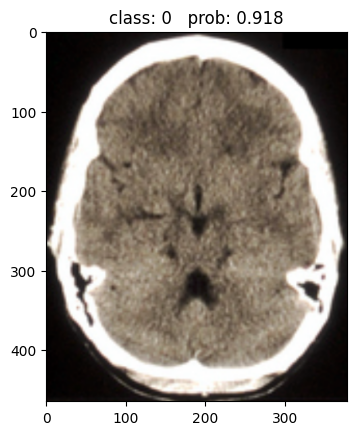

tensor([0.9180, 0.0820])


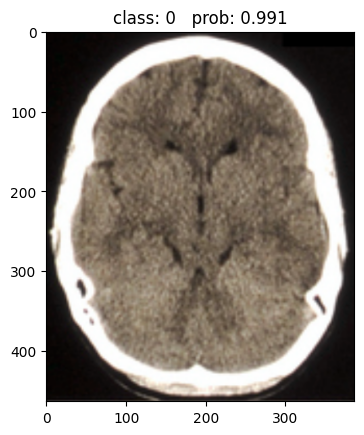

tensor([0.9909, 0.0091])


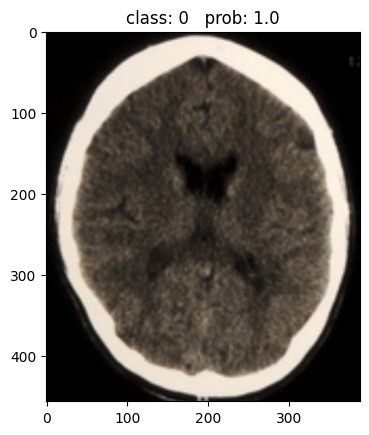

tensor([9.9970e-01, 2.9869e-04])


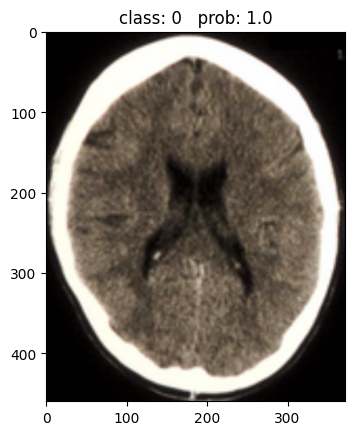

tensor([9.9988e-01, 1.1859e-04])


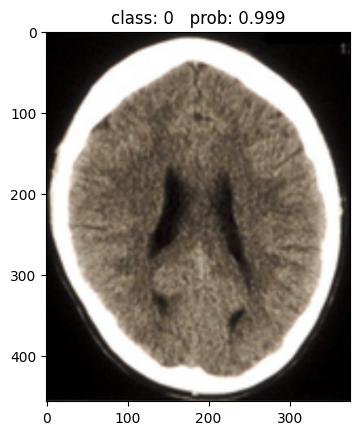

tensor([9.9943e-01, 5.7182e-04])


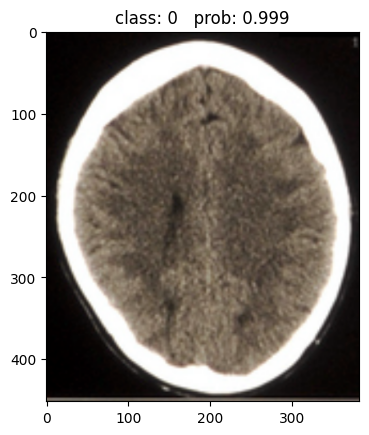

tensor([9.9949e-01, 5.0930e-04])


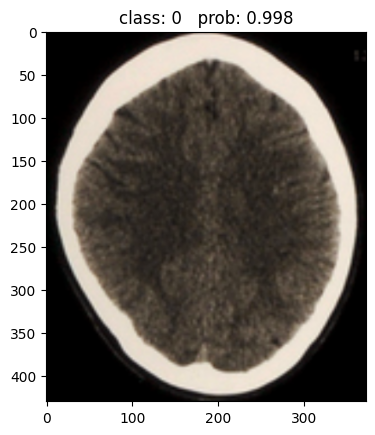

tensor([0.9980, 0.0020])


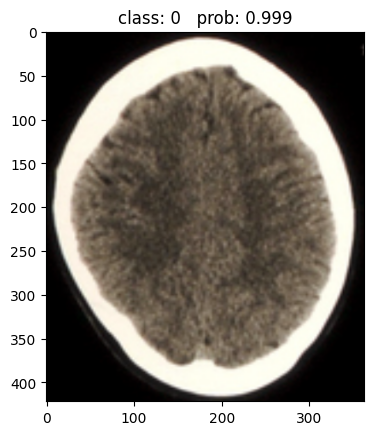

tensor([9.9915e-01, 8.5420e-04])


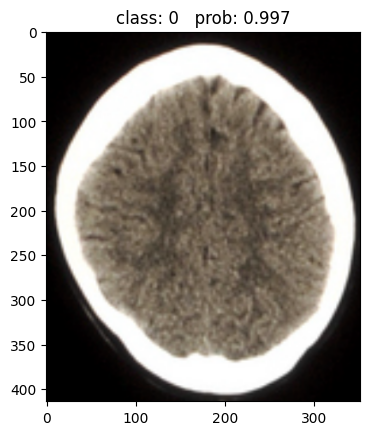

tensor([0.9967, 0.0033])


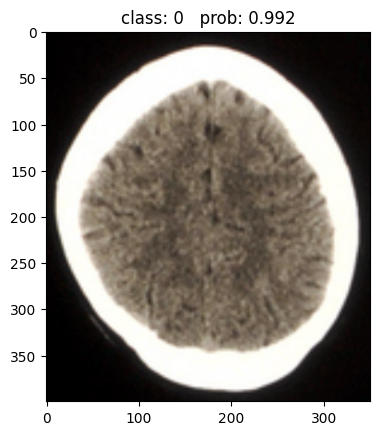

tensor([0.9920, 0.0080])


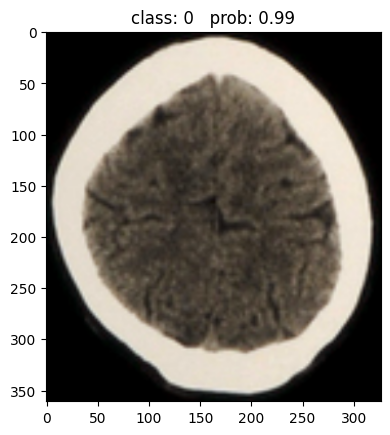

tensor([0.9903, 0.0097])


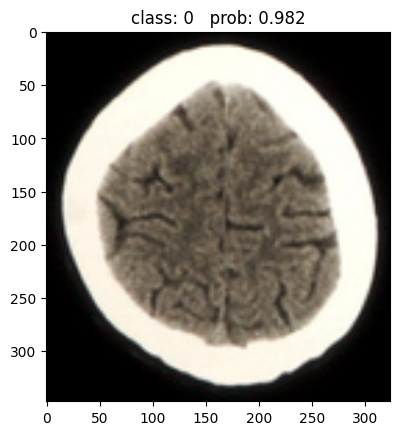

tensor([0.9817, 0.0183])


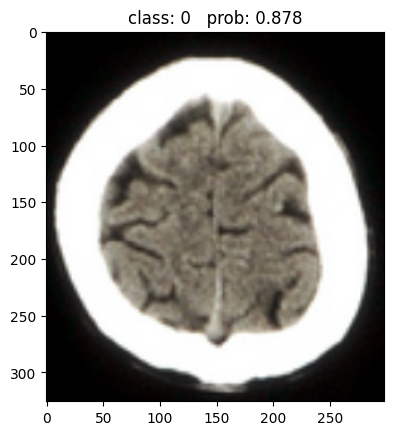

tensor([0.8783, 0.1217])


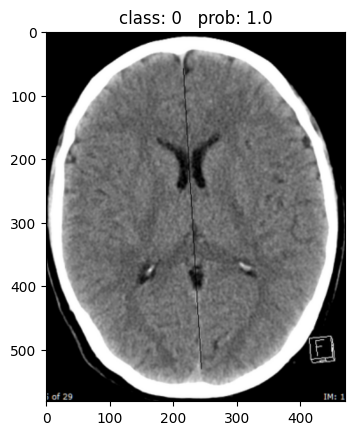

tensor([1.0000e+00, 5.2618e-10])


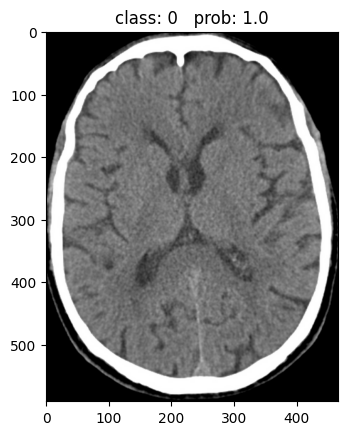

tensor([1.0000e+00, 5.6786e-07])


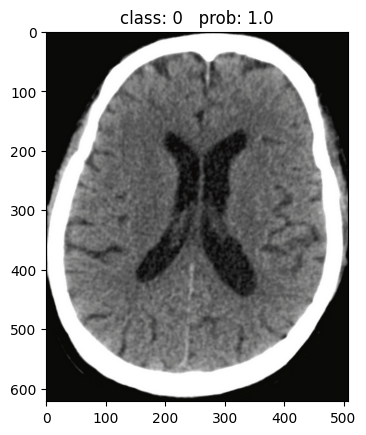

tensor([9.9999e-01, 5.0987e-06])


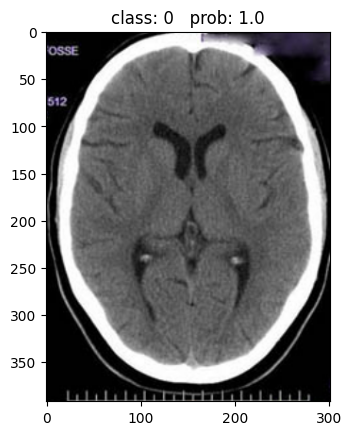

tensor([9.9999e-01, 8.4461e-06])


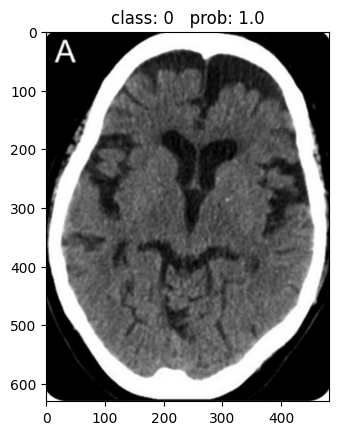

tensor([9.9997e-01, 2.8683e-05])


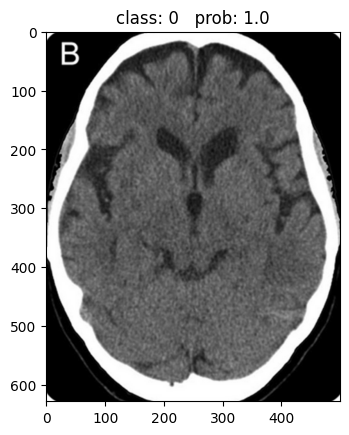

tensor([9.9991e-01, 8.7104e-05])


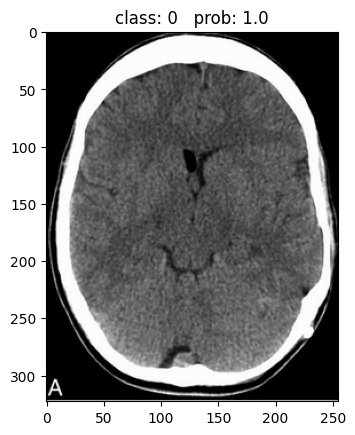

tensor([9.9993e-01, 7.4888e-05])


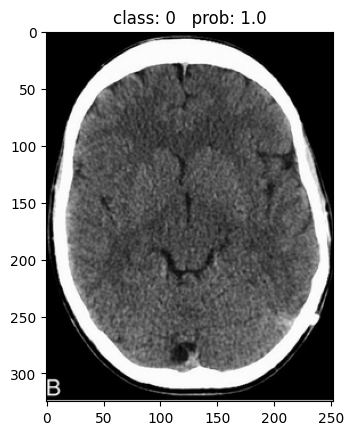

tensor([9.9988e-01, 1.2062e-04])


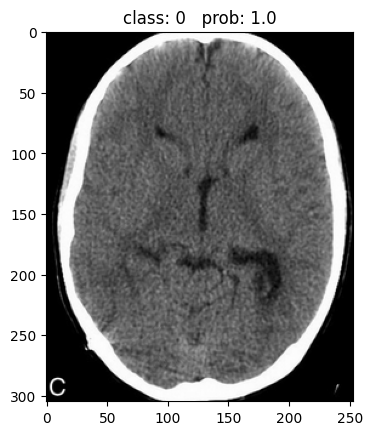

tensor([9.9999e-01, 1.3221e-05])


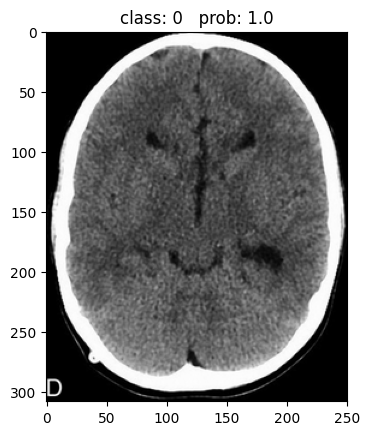

tensor([9.9998e-01, 2.3648e-05])


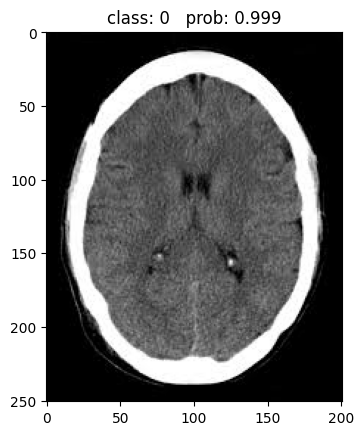

tensor([9.9941e-01, 5.9168e-04])


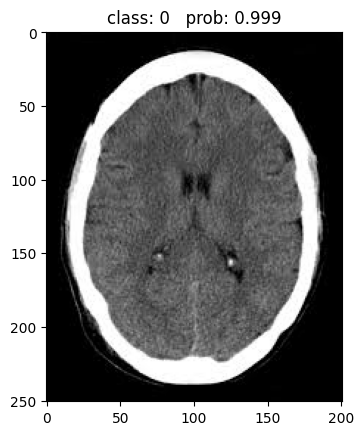

tensor([9.9941e-01, 5.9168e-04])


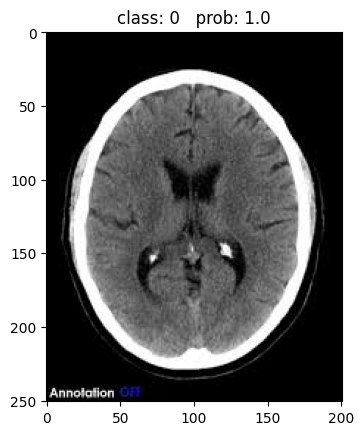

tensor([9.9984e-01, 1.6437e-04])


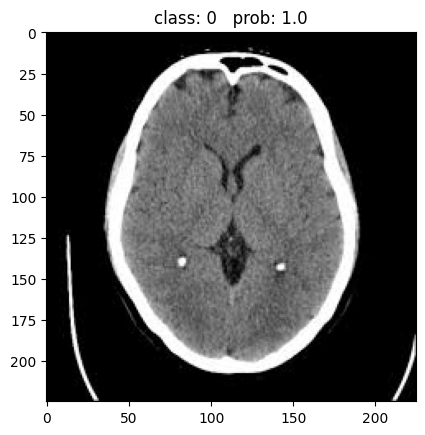

tensor([9.9994e-01, 5.9922e-05])


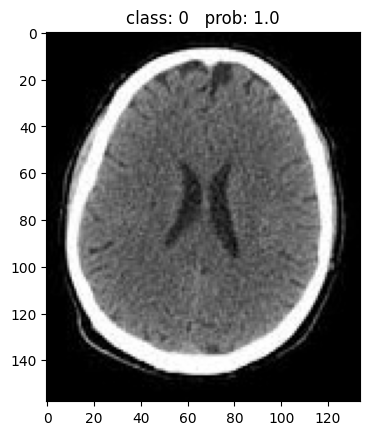

tensor([9.9995e-01, 4.8074e-05])


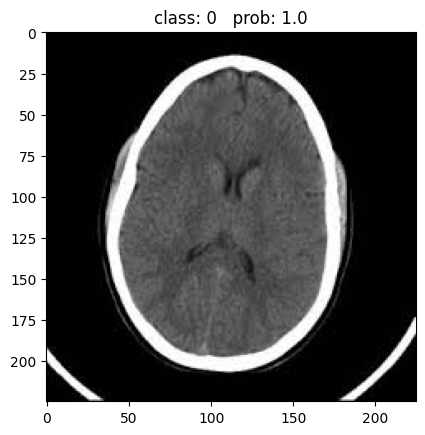

tensor([9.9998e-01, 2.2885e-05])


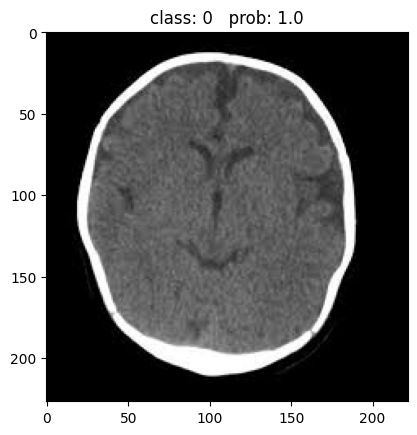

tensor([1.0000e+00, 4.5209e-07])


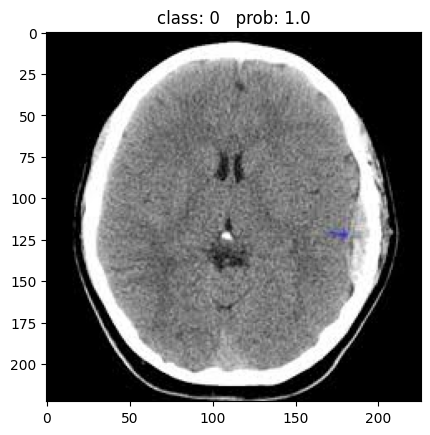

tensor([9.9998e-01, 2.1893e-05])


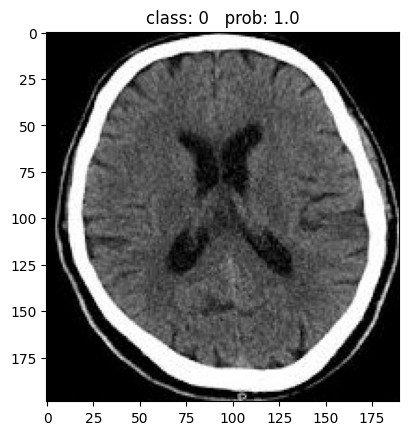

tensor([9.9995e-01, 4.7052e-05])


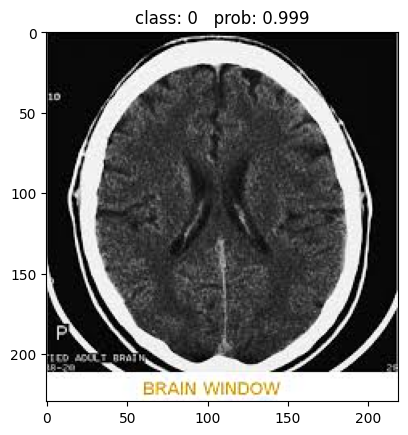

tensor([9.9927e-01, 7.3328e-04])


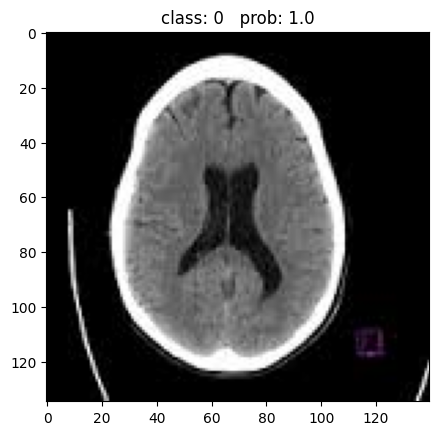

tensor([9.9998e-01, 1.7323e-05])


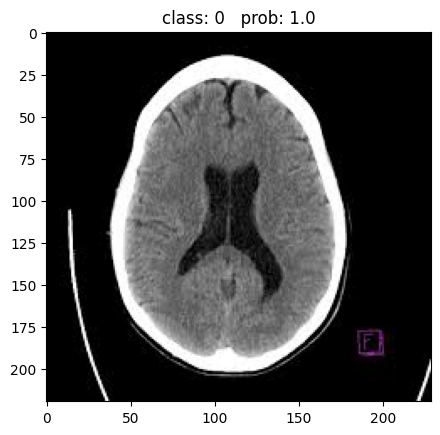

tensor([9.9999e-01, 1.0725e-05])


In [17]:
for img in images:
    img = Image.fromarray(img)
    plt.imshow(img)
    
    # plt.imshow(img)
    # [N, C, H, W]
    img = data_transform(img)
    # expand batch dimension
    img = torch.unsqueeze(img, dim=0)

    model.eval()
    with torch.no_grad():
        # predict class
        output = torch.squeeze(model(img.to(device))).cpu()
        predict = torch.softmax(output, dim=0)
        predict_cla = torch.argmax(predict).numpy()

    print_res = "class: {}   prob: {:.3}".format(class_indict[str(predict_cla)],
                                                 predict[predict_cla].numpy())
    plt.title(print_res)
    plt.show()
    
    print(predict)
    if class_indict[str(predict_cla)]=="1":
        acc+=1